In [1]:
import sys
sys.version

'3.7.11 (default, Jan 28 2022, 19:13:48) \n[GCC 9.3.0]'

In [2]:
import fil_finder
from fil_finder import FilFinder2D, Filament2D
from astropy.io import fits
from scipy.stats import norm
from scipy.optimize import curve_fit
import copy
import aplpy

In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
import astropy.units as u

# Optional settings for the plots. Comment out if needed.
# import seaborn as sb
# sb.set_context('poster')

import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12., 9.6)

In [4]:
def v2ch(v, w): # v(km/s)をchに変える
    x_tempo, y_tempo, v_tempo   = w.wcs_pix2world(0, 0, 0, 0)
    x_ch, y_ch, v_ch   = w.wcs_world2pix(x_tempo, y_tempo, v*1000.0, 0)
    v_ch = int(round(float(v_ch), 0))
    return v_ch

def del_header_key(header, keys): # headerのkeyを消す
    import copy
    h = copy.deepcopy(header)
    for k in keys:
        try:
            del h[k]
        except:
            pass
    return h
def make_new_hdu_integ(hdu, v_start_wcs, v_end_wcs, w): # 積分強度のhduを作る
    data = hdu.data
    header = hdu.header
    start_ch, end_ch = v2ch(v_start_wcs, w), v2ch(v_end_wcs, w)
    new_data = np.nansum(data[start_ch:end_ch+1], axis=0)*np.abs(header["CDELT3"])/1000.0
    header = del_header_key(header, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    header["NAXIS"] = 2
#     header["CTYPE1"] = "GLON-CAR"
#     header["CTYPE2"] = "GLAT-CAR"
    new_data[new_data==0.0]=np.nan
    try:
        header["WCSAXES"] = 2
    except:
        pass
    new_hdu = fits.PrimaryHDU(new_data, header)
    return new_hdu

In [5]:
from astropy.wcs import WCS
import numpy as np
from spectral_cube import Projection
import astropy
import aplpy

In [6]:
# fits_pwd = "/home/filament/Desktop/fil-test/fil_finder_fits/test_5.fits"
# fits_pwd = "/home/filament/Desktop/fil-test/fil_finder_fits/TAN/test_1_TAN.fits"
fits_pwd = "/home/filament/Desktop/fil-test/fil_finder_fits/AIT/test_6.fits"
hdu = fits.open(fits_pwd)[0]
w = WCS(fits_pwd)


In [7]:
fits.PrimaryHDU(hdu.data.astype("float32"),hdu.header).writeto("/home/filament/Desktop/fil-test/fil_finder_fits/AIT/test_6_float32.fits")

OSError: File '/home/filament/Desktop/fil-test/fil_finder_fits/AIT/test_6_float32.fits' already exists.

In [ ]:
fits_pwd.split('/')[7].split('.')[0]

In [ ]:
hdu.data.shape

In [ ]:
hdu.data.shape[1],hdu.data.shape[2]

In [10]:
hdu.header

SIMPLE  =                    T                                                  
BITPIX  =                  -64                                                  
NAXIS   =                    3                                                  
NAXIS1  =                 1449                                                  
NAXIS2  =                  952                                                  
NAXIS3  =                  933                                                  
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
CTYPE1  = 'GLON-AIT'                                                            
CTYPE2  = 'GLAT-AIT'                                                            
CRVAL1  =          0.000000000                                                  
CRVAL2  =          0.0000000

In [11]:
hdu.header["CUNIT1"] = "deg"
hdu.header["CUNIT2"] = "deg"
hdu.header["BPA"] = 0.0
hdu.header["BMAJ"] = 0.2706
hdu.header["BMIN"] = 0.2706
hdu.header["LONPOLE"] = 180.0
hdu.header["LATPOLE"] = 90.0


In [12]:
# del hdu.header["LONGPOLE"]
# del hdu.header["LONPOLE"]
# del hdu.header["LATPOLE"]

In [13]:
##########
integ_hdu = make_new_hdu_integ(hdu, 20.0, 50.0, w)
##########

In [14]:
# integ_hdu.writeto("./20_50_COE_north.fits",overwrite=True)

In [15]:
hdr1 = fits.PrimaryHDU().header
hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
hdr1["CDELT1"] = -0.01
# hdr1["CDELT1"] = -0.001
hdr1["CDELT2"] = 0.01
# hdr1["CDELT2"] = 0.001
hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
# hdr1["CRVAL1"] = 0
hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
# hdr1["CRVAL2"] = 0
hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
# hdr1["CTYPE1"] = "GLON-CAR"
hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
# hdr1["CTYPE2"] = "GLAT-CAR"
hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
hdr1["BPA"] = integ_hdu.header["BPA"]
hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
hdr1["BMIN"] = integ_hdu.header["BMIN"]
hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]


In [16]:
hdr1

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                  -64 / array data type                                
NAXIS   =                    2 / number of array dimensions                     
EXTEND  =                    T                                                  
NAXIS1  =                 1449                                                  
NAXIS2  =                  952                                                  
CDELT1  =                -0.01                                                  
CDELT2  =                 0.01                                                  
CRVAL1  =                  0.0                                                  
CRVAL2  =                  0.0                                                  
CRPIX1  =                725.5                                                  
CRPIX2  =                138.5                                                  
CTYPE1  = 'GLON-AIT'        

In [17]:
# w = WCS(hdu)


# v_start,v_end,d,bmaj,cdelt,vmin,vmax = 20,50,10,0.2706,0.083333333,1,450
# ##########################
# #     wcs = WCS(hdu.header)
# ##########################


# integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
# integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
# hdr1 = fits.PrimaryHDU().header
# hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
# hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
# hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
# hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
# hdr1["CDELT1"] = -cdelt
# hdr1["CDELT2"] = cdelt
# hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
# hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
# hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
# hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
# hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
# hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
# hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
# hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
# #     hdr1["BPA"] = integ_hdu.header["BPA"]
# #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
# #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
# #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
# #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



# # fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

# # fil.preprocess_image(flatten_percent=95)
# # fil.create_mask(verbose=True)
# # fil.medskel(verbose=True)
# # fil_skeleton= fil.skeleton
# # fil_skeleton = fil_skeleton.astype("int")
# # hdr2 = copy.deepcopy(hdu.header)
# # hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
# # hdr2["NAXIS"]=2
# # hdr2["WCSAXES"]=2

# # fig = aplpy.FITSFigure(integ_hdu,slices=[0])
# # fig.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
# # fig.add_colorbar()
# # fig.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
# # fig.add_grid()
# # fig.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
# # fig.savefig("/home/filament/Downloads/fil_remake/%s_%i_%i.png"%(fits_pwd.split('/')[5].split('.')[0],v_start,v_end))
# integ_hdu.writeto("/home/filament/Downloads/fil_remake/nor_%i_%i.fits"%(v_start,v_end), overwrite=True)


# plt.clf()

In [18]:
# hdu.writeto("./region_1_AIT.fits",overwrite=True)

In [19]:
v_list_1_p = [[0,10],[10,20],[20,30],[30,40],[40,50],[50,60],[60,70],[70,80],[80,90],[90,100]]
v_list_1_n = [[-100,-90],[-90,-80],[-80,-70],[-70,-60],[-60,-50],[-50,-40],[-40,-30],[-30,-20],[-20,-10],[-10,0]]
v_list_2 = [[20,35],[35,50],[50.65],[65,80],[80,95],[95,110]]
v_list_3 = [[20,40],[40,60],[60,80],[80,100]]

AIT

north

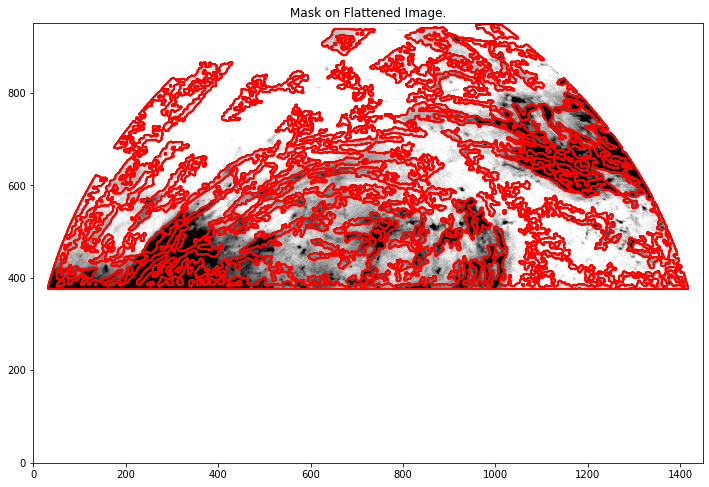

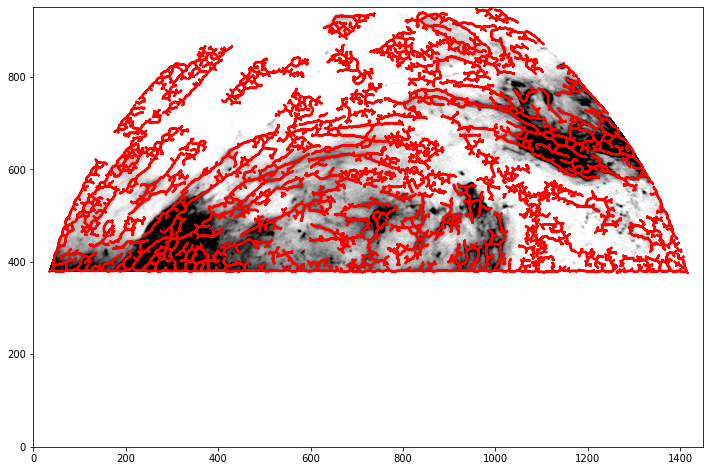

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:217: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

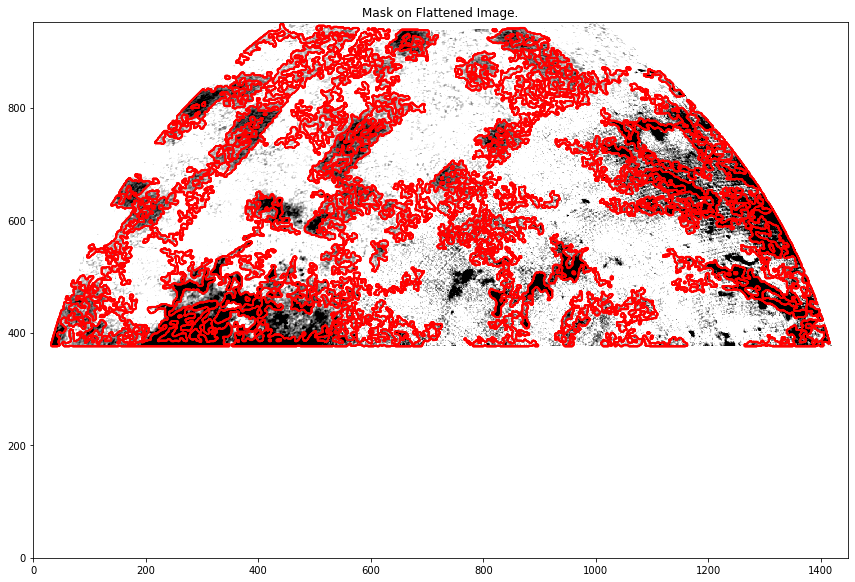

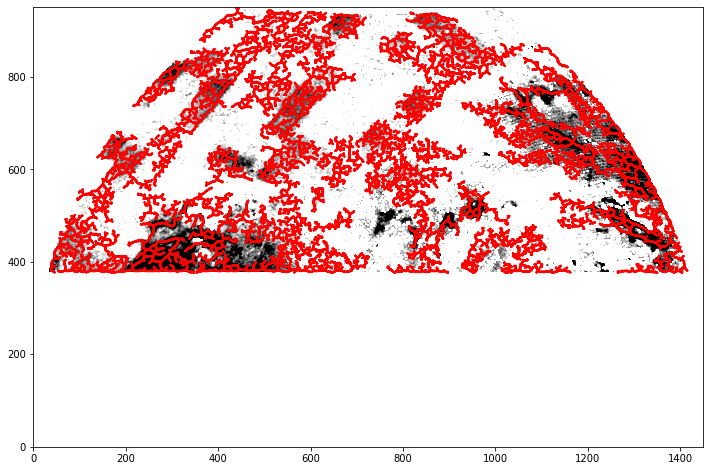

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

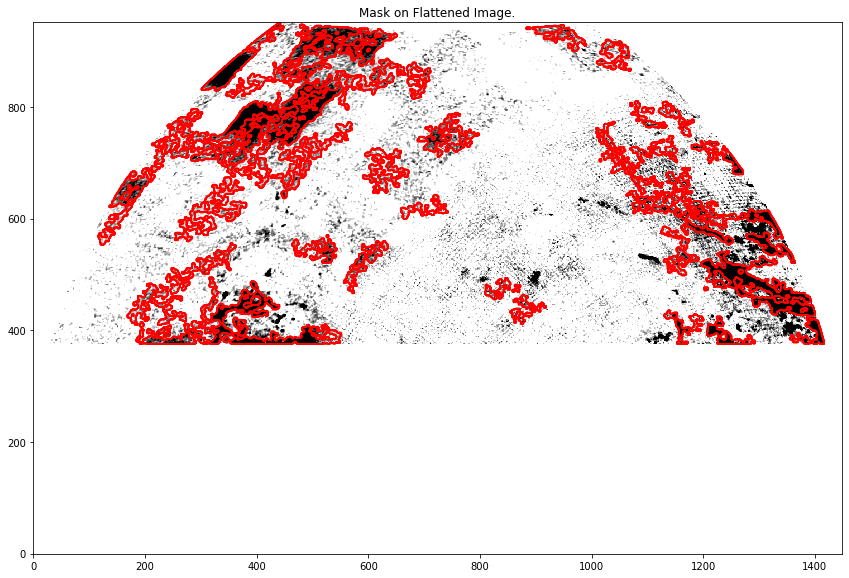

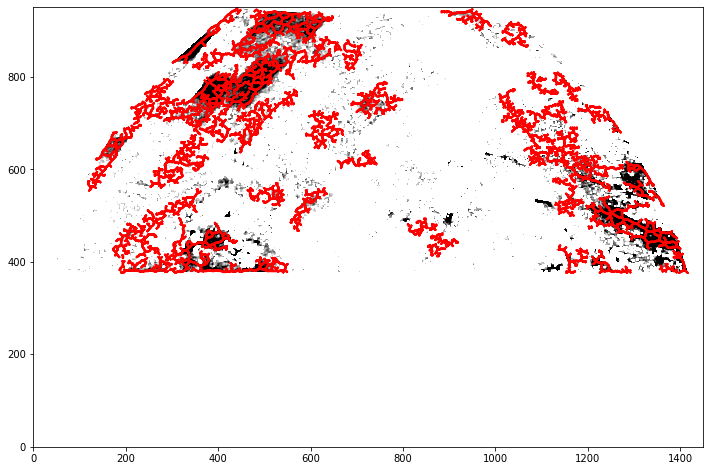

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

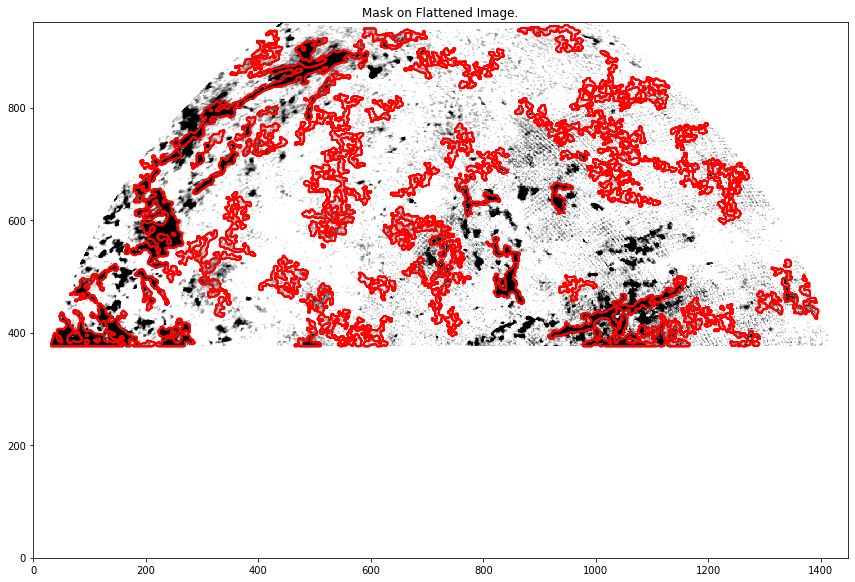

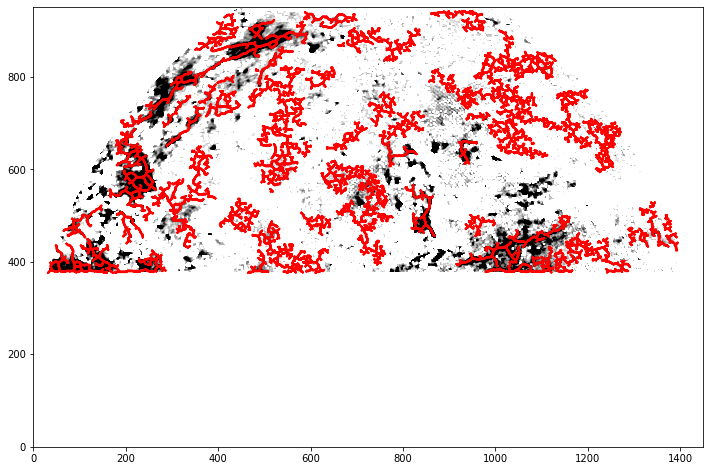

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

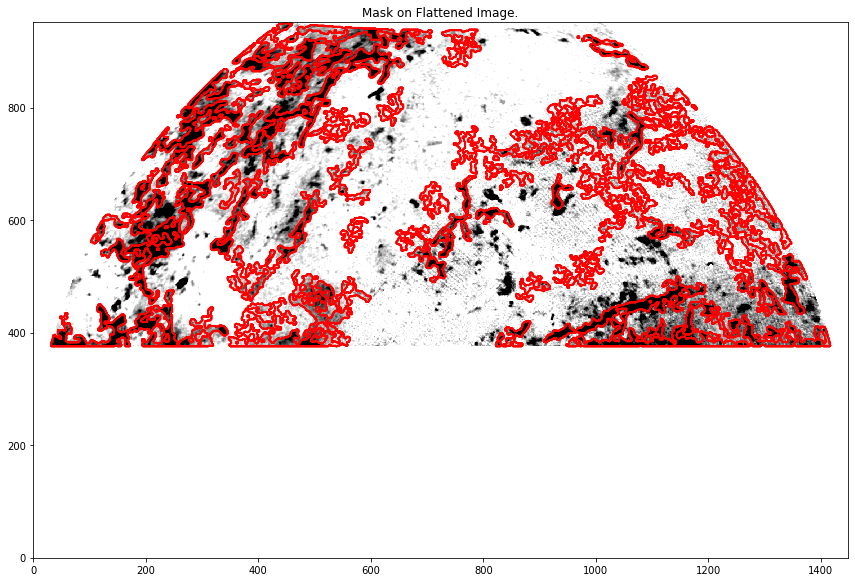

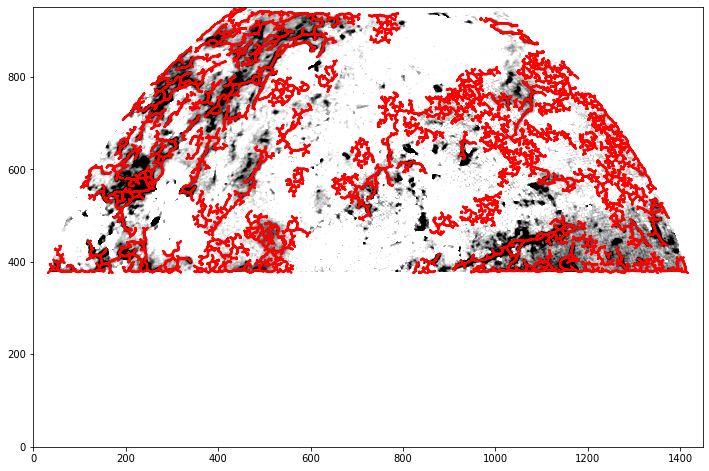

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

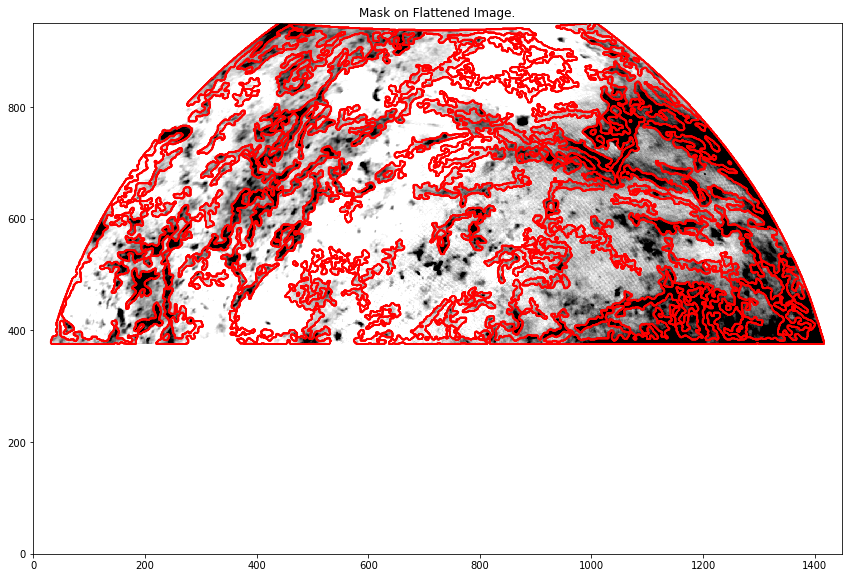

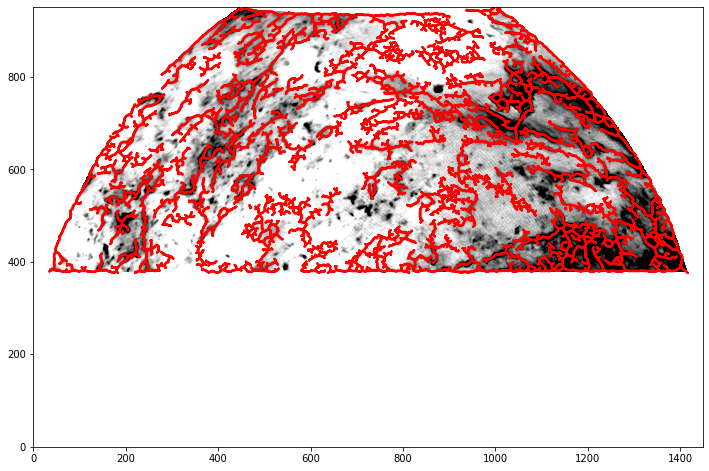

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:217: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

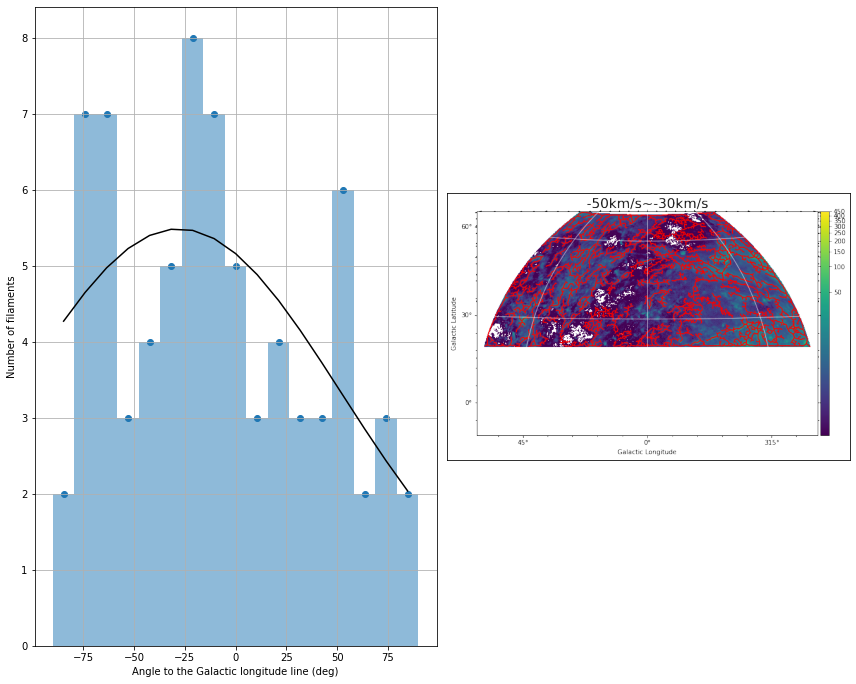

In [20]:
w = WCS(hdu)

fig_name = 0

if fits_pwd.split('/')[7].split('.')[0] == "test_1":
    fig_name = "region1"
elif fits_pwd.split('/')[7].split('.')[0] == "test_2":
    fig_name = "region2"
elif fits_pwd.split('/')[7].split('.')[0] == "test_3":
    fig_name = "region3"
elif fits_pwd.split('/')[7].split('.')[0] == "test_4":
    fig_name = "region4"
elif fits_pwd.split('/')[7].split('.')[0] == "test_5":
    fig_name = "region5"
elif fits_pwd.split('/')[7].split('.')[0] == "test_6":
    fig_name = "region6"


p_n_v = [[30,50],[50,70],[70,100],[-100,-70],[-70,-50],[-50,-30]]
# p_n_v = [[30,50]]

for i,j in enumerate(p_n_v):
    v_start,v_end,d,bmaj,cdelt,vmin,vmax = j[0],j[1],10,0.2706,0.083333333,1,450
    ##########################
    #     wcs = WCS(hdu.header)
    ##########################


    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan####0.01
    xpix_tempo,ypix_tempo,vpix_tempo = w.wcs_world2pix(0,20,0,0)
    integ_hdu.data[:int(ypix_tempo),:]=np.nan
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
    #     hdr1["BPA"] = integ_hdu.header["BPA"]
    #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
    #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
    #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
    #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True,border_masking=False)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2

    fig = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig.add_colorbar()
    fig.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig.add_grid()
    
    plt.rcParams["font.size"] = 18
    
    fig.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
    fig.savefig("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/%s_%i_%i.png"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end))
    # integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
    plt.rcParams["font.size"] = 10
    integ_hdu.writeto("/home/filament/Desktop/fil-test/integ_fits/AIT/"+fig_name+"/"+fits_pwd.split('/')[7].split('.')[0]+"%i_%i.fits"%(v_start,v_end), overwrite=True)

    plt.clf()
    fil.analyze_skeletons()
#     fil.analyze_skeletons(nbeam_lengths=3, branch_nbeam_lengths=3, branch_thresh=10*u.pix, skel_thresh=10*u.pix, prune_criteria='all')
    fil.exec_rht()
    fil.find_widths(max_dist=10 * u.pix)

    ypos = np.array([f.position()[0].value for f in fil.filaments])


    lean_ls = []

    pa_deg_map = np.zeros(hdu.data.shape[1:])
    for i in range(hdu.data.shape[2]):
        for j in range(hdu.data.shape[1]):

            pos = w.wcs_pix2world(i,j,0,0)
            if np.isnan(pos[0])==True or np.isnan(pos[1])==True:
                lean_ls.append(0)
                pa_deg_map[[j],[i]]=np.nan
                continue
            slide_plus = np.array([pos[0],pos[1]+0.0001])
            slide_minus = np.array([pos[0],pos[1]-0.0001])
            slide_plus_pix = w.wcs_world2pix(slide_plus[0],slide_plus[1],0,0)
            slide_minus_pix = w.wcs_world2pix(slide_minus[0],slide_minus[1],0,0)
            vec = np.array(slide_plus_pix) - np.array(slide_minus_pix)
    #         vec = np.array([slide_plus_pix[0]-slide_minus_pix[0],slide_plus_pix[1]-slide_minus_pix[1]])
            lean = -vec[0]/vec[1]  #
    #         print(lean)
    #         print(np.arctan(lean))
            lean_ls.append(np.rad2deg(np.arctan(lean)))
            pa_deg_map[[j],[i]]=np.rad2deg(np.arctan(lean))


    fig = aplpy.FITSFigure(integ_hdu,slices=[0])

    plt.imshow(pa_deg_map)
    fig.add_grid()
    plt.colorbar()
    fig.ticks.set_xspacing(5)
    fig.ticks.set_yspacing(5)

    fil_ori_ = []
    fil_int = []
    for f in fil.filaments:
        pa = np.rad2deg(f.orientation.value)-pa_deg_map[int(f.position()[0].value)][int(f.position()[1].value)]
        fil_ori_.append(pa)
        fil_int.append(f.total_intensity())
    fil_ori_=np.array(fil_ori_)
    ypos = np.array([f.position()[0].value for f in fil.filaments])
    fil_ori_=np.where(fil_ori_<-90,fil_ori_+180,fil_ori_)
    fil_ori_=np.where(fil_ori_>90,fil_ori_-180,fil_ori_)
    # -90deg以下のものには+180deg、90deg以上のものには-180degをして±90degの範囲に収める。
    # plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))

    ##################################################
    a,b,c = plt.hist(fil_ori_,alpha=0.5,bins=np.linspace(-90,90,num=18))
    np.save("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/ori_%s_%i_%i.npy"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end),fil_ori_)
    np.save("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/tot_int_%s_%i_%i.npy"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end),fil_int)
    b_ls = []
    for i in range(len(b)-1):
        b_ls.append((b[i]+b[i+1])/2)

    def func(x, a, mu, sigma):
        return a*np.exp(-(x-mu)**2/(2*sigma**2))

    param_ini = [10,10,10]

    try:
        popt, pcov = curve_fit(func, b_ls, a,p0=param_ini,maxfev=1000)
        
        np.save("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/popt_%s_%i_%i.npy"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end),popt)
        np.save("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/pcov_%s_%i_%i.npy"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end),pcov)

    except RuntimeError:
        pass

    try:
        fitting = func(b_ls, popt[0],popt[1],popt[2])
    except NameError:
        pass
    ##################################################


    plt.clf()



    #確率分布のスケールを変える
    #確率分布に従って、全データ数と同じ数のサンプルを発生させたときの予測値をプロットする。このとき、プロットの x 座標にはヒストグラムの各ビンの中心を用いる。
    fig = plt.figure()
    ax1 = plt.subplot(1,2,1)
    ax2 = plt.subplot(1,2,2)

    # img = plt.imread("/home/filament/Downloads/fil_remake/"+fits_pwd.split('/')[7].split('.')[0]+"_"+str(v_start)+"_"+str(v_end)+".png")

    img = plt.imread("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/%s_%i_%i.png"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end))

    plt.rcParams["font.size"] = 18
    # plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
    # plt.xlabel('Angle to the Galactic longitude line (deg)')
    # plt.ylabel('Number of filaments')


    # ax1.plot(b_mid,y) # ビンの中心に、確率分布から予想される高さをプロット
    ax1.scatter(b_ls,a)
    ax1.hist(fil_ori_,alpha=0.5,bins=np.linspace(-90,90,num=18))

    try:
        ax1.plot(b_ls,fitting,'k')
    except NameError:
        pass



    ax1.set_xlabel('Angle to the Galactic longitude line (deg)')
    ax1.set_ylabel('Number of filaments')


    # ax2.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
    # plt.xlabel('Angle to the Galactic longitude line (deg)')
    # plt.ylabel('Number of filaments')
    # ax2.set_xlabel('Angle to the Galactic longitude line (deg)')
    # ax2.set_ylabel('Number of filaments')

    ax2.imshow(img)
    ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)


    ax1.grid()
    # ax2.grid()
    plt.rcParams["font.size"] = 10
    #plt.showではなくfig.show()にしないとsubplotの場合はうまくsubplotで表示してくれない！！
    # plt.show
    fig.show()

    plt.tight_layout()


    plt.savefig("/home/filament/Desktop/fil-test/PA_gaussianfit/AIT/"+fig_name+"/"+fig_name+"_"+str(v_start)+"_"+str(v_end)+"_PA_gaussian.png")

north COE

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filfinder2D.py:355: UserWarning: Adaptive thresholding patch is larger than 40pixels. Regridding has been disabled.
  warnings.warn("Adaptive thresholding patch is larger than 40"


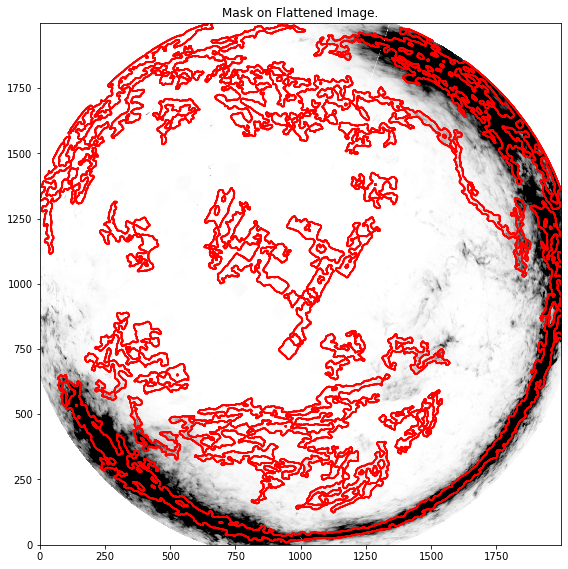

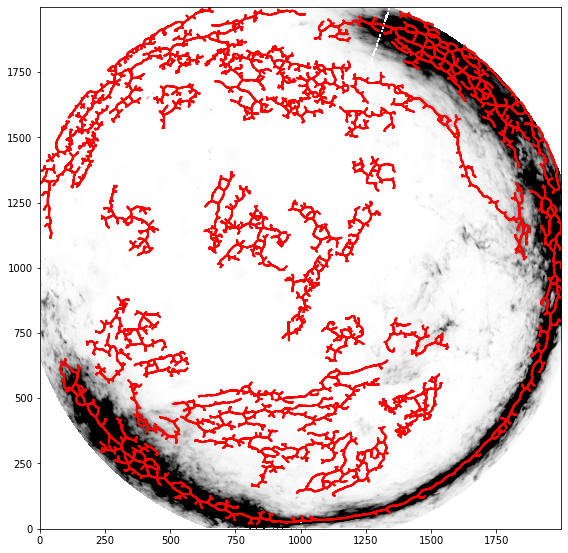

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:94: RuntimeWarning: divide by zero encountered in double_scalars
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:94: RuntimeWarning: invalid value enc

FileNotFoundError: [Errno 2] No such file or directory: '/home/filament/Desktop/fil-test/fil_finder.png/COE/region_nor_COE/region_nor_COE_30_50.png'

<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

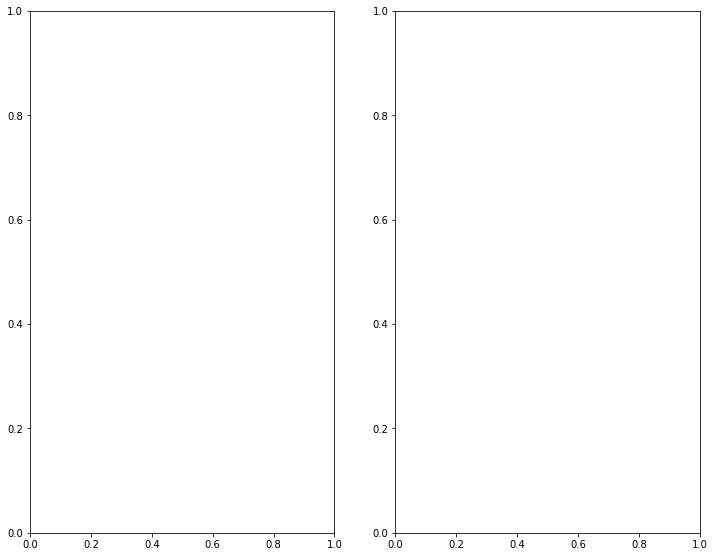

In [18]:
w = WCS(hdu)

fig_name = 'region_nor_COE'


p_n_v = [[30,50],[50,70],[70,100],[-100,-70],[-70,-50],[-50,-30]]

for i,j in enumerate(p_n_v):
    v_start,v_end,d,bmaj,cdelt,vmin,vmax = j[0],j[1],3,0.2706,0.083333333,1,450
    ##########################
    #     wcs = WCS(hdu.header)
    ##########################


    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan####0.01
#     xpix_tempo,ypix_tempo,vpix_tempo = w.wcs_world2pix(0,20,0,0)
#     integ_hdu.data[:int(ypix_tempo),:]=np.nan
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
#     hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE1"] = "GLON-CAR"
#     hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CTYPE2"] = "GLAT-CAR"
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
    #     hdr1["BPA"] = integ_hdu.header["BPA"]
    #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
    #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
    #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
    #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True,border_masking=False)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2

    fig = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig.add_colorbar()
    fig.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig.add_grid()
    fig.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
#     fig.savefig("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/%s_%i_%i.png"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end))
    # integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
#     integ_hdu.writeto("/home/filament/Desktop/fil-test/integ_fits/AIT/"+fig_name+"/"+fits_pwd.split('/')[7].split('.')[0]+"%i_%i.fits"%(v_start,v_end), overwrite=True)

    plt.clf()
    fil.analyze_skeletons()
#     fil.analyze_skeletons(nbeam_lengths=3, branch_nbeam_lengths=3, branch_thresh=10*u.pix, skel_thresh=10*u.pix, prune_criteria='all')
    fil.exec_rht()
    fil.find_widths(max_dist=10 * u.pix)

    ypos = np.array([f.position()[0].value for f in fil.filaments])


    lean_ls = []

    pa_deg_map = np.zeros(hdu.data.shape[1:])
    for i in range(hdu.data.shape[2]):
        for j in range(hdu.data.shape[1]):

            pos = w.wcs_pix2world(i,j,0,0)
            if np.isnan(pos[0])==True or np.isnan(pos[1])==True:
                lean_ls.append(0)
                pa_deg_map[[j],[i]]=np.nan
                continue
            slide_plus = np.array([pos[0],pos[1]+0.0001])
            slide_minus = np.array([pos[0],pos[1]-0.0001])
            slide_plus_pix = w.wcs_world2pix(slide_plus[0],slide_plus[1],0,0)
            slide_minus_pix = w.wcs_world2pix(slide_minus[0],slide_minus[1],0,0)
            vec = np.array(slide_plus_pix) - np.array(slide_minus_pix)
    #         vec = np.array([slide_plus_pix[0]-slide_minus_pix[0],slide_plus_pix[1]-slide_minus_pix[1]])
            lean = -vec[0]/vec[1]  #
    #         print(lean)
    #         print(np.arctan(lean))
            lean_ls.append(np.rad2deg(np.arctan(lean)))
            pa_deg_map[[j],[i]]=np.rad2deg(np.arctan(lean))


    fig = aplpy.FITSFigure(integ_hdu,slices=[0])

    plt.imshow(pa_deg_map)
    fig.add_grid()
    plt.colorbar()
    fig.ticks.set_xspacing(5)
    fig.ticks.set_yspacing(5)

    fil_ori_ = []
    fil_int = []
    for f in fil.filaments:
        pa = np.rad2deg(f.orientation.value)-pa_deg_map[int(f.position()[0].value)][int(f.position()[1].value)]
        fil_ori_.append(pa)
        fil_int.append(f.total_intensity())
    fil_ori_=np.array(fil_ori_)
    ypos = np.array([f.position()[0].value for f in fil.filaments])
    fil_ori_=np.where(fil_ori_<-90,fil_ori_+180,fil_ori_)
    fil_ori_=np.where(fil_ori_>90,fil_ori_-180,fil_ori_)
    # -90deg以下のものには+180deg、90deg以上のものには-180degをして±90degの範囲に収める。
    # plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))

    ##################################################
    a,b,c = plt.hist(fil_ori_,alpha=0.5,bins=np.linspace(-90,90,num=18))
#     np.save("/home/filament/Desktop/fil-test/fil_finder.png/COE/"+fig_name+"/ori_%s_%i_%i.npy"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end),fil_ori_)
#     np.save("/home/filament/Desktop/fil-test/fil_finder.png/COE/"+fig_name+"/tot_int_%s_%i_%i.npy"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end),fil_int)
    b_ls = []
    for i in range(len(b)-1):
        b_ls.append((b[i]+b[i+1])/2)

    def func(x, a, mu, sigma):
        return a*np.exp(-(x-mu)**2/(2*sigma**2))

    param_ini = [10,10,10]

    try:
        popt, pcov = curve_fit(func, b_ls, a,p0=param_ini,maxfev=1000)
        
        np.save("/home/filament/Desktop/fil-test/fil_finder.png/COE/"+fig_name+"/popt_%s_%i_%i.npy"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end),popt)
        np.save("/home/filament/Desktop/fil-test/fil_finder.png/COE/"+fig_name+"/pcov_%s_%i_%i.npy"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end),pcov)

    except RuntimeError:
        pass

    try:
        fitting = func(b_ls, popt[0],popt[1],popt[2])
    except NameError:
        pass
    ##################################################


    plt.clf()



    #確率分布のスケールを変える
    #確率分布に従って、全データ数と同じ数のサンプルを発生させたときの予測値をプロットする。このとき、プロットの x 座標にはヒストグラムの各ビンの中心を用いる。
    fig = plt.figure()
    ax1 = plt.subplot(1,2,1)
    ax2 = plt.subplot(1,2,2)

    # img = plt.imread("/home/filament/Downloads/fil_remake/"+fits_pwd.split('/')[7].split('.')[0]+"_"+str(v_start)+"_"+str(v_end)+".png")

#     img = plt.imread("/home/filament/Desktop/fil-test/fil_finder.png/COE/"+fig_name+"/%s_%i_%i.png"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end))

    plt.rcParams["font.size"] = 18
    # plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
    # plt.xlabel('Angle to the Galactic longitude line (deg)')
    # plt.ylabel('Number of filaments')


    # ax1.plot(b_mid,y) # ビンの中心に、確率分布から予想される高さをプロット
    ax1.scatter(b_ls,a)
    ax1.hist(fil_ori_,alpha=0.5,bins=np.linspace(-90,90,num=18))

    try:
        ax1.plot(b_ls,fitting,'k')
    except NameError:
        pass



    ax1.set_xlabel('Angle to the Galactic longitude line (deg)')
    ax1.set_ylabel('Number of filaments')


    # ax2.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
    # plt.xlabel('Angle to the Galactic longitude line (deg)')
    # plt.ylabel('Number of filaments')
    # ax2.set_xlabel('Angle to the Galactic longitude line (deg)')
    # ax2.set_ylabel('Number of filaments')

    ax2.imshow(img)
    ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)


    ax1.grid()
    # ax2.grid()
    plt.rcParams["font.size"] = 10
    #plt.showではなくfig.show()にしないとsubplotの場合はうまくsubplotで表示してくれない！！
    # plt.show
    fig.show()

    plt.tight_layout()


#     plt.savefig("/home/filament/Desktop/fil-test/PA_gaussianfit/COE/"+fig_name+"/"+fig_name+"_"+str(v_start)+"_"+str(v_end)+"_PA_gaussian.png")

INFO: Auto-setting vmin to  1.743e-02 [aplpy.core]
INFO: Auto-setting vmax to  1.644e+03 [aplpy.core]


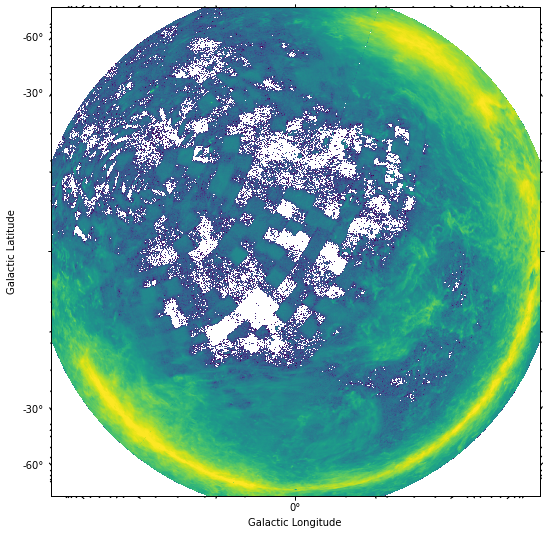

In [23]:
F = aplpy.FITSFigure(integ_hdu)
F.show_colorscale(stretch="log")

INFO: Auto-setting vmax to  1.613e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.401e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.457e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.531e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.420e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.725e+03 [aplpy.core]


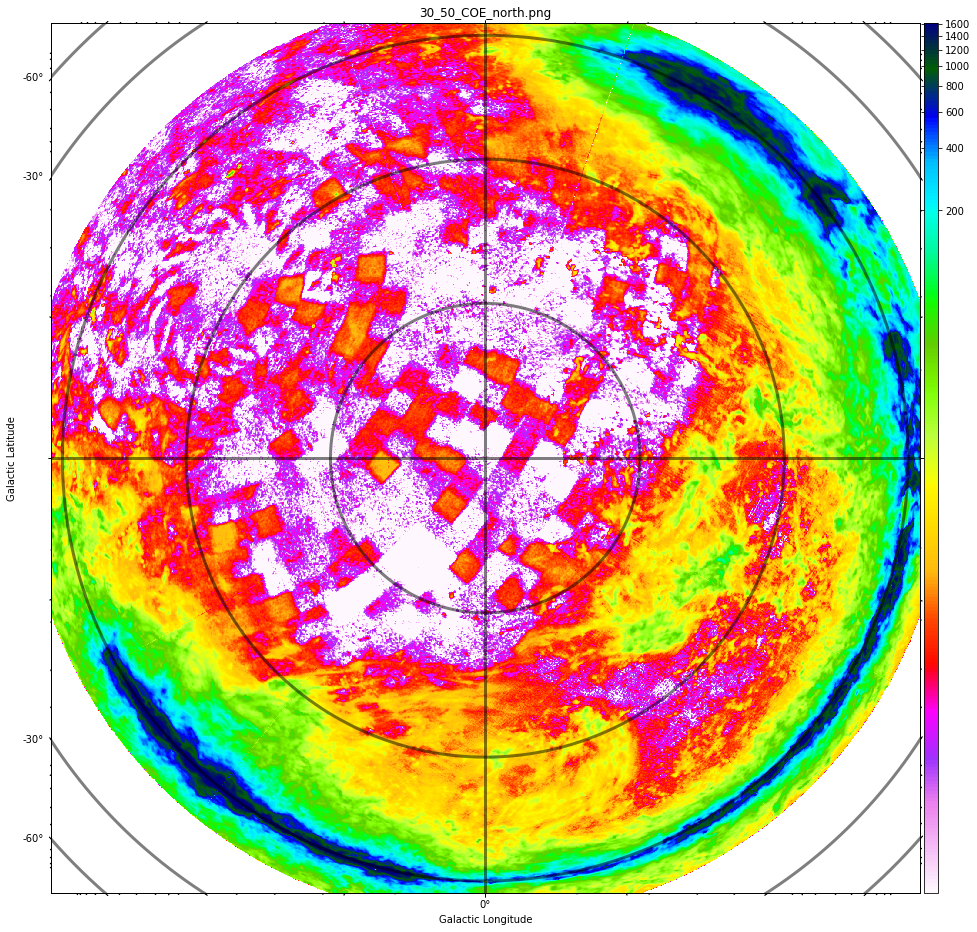

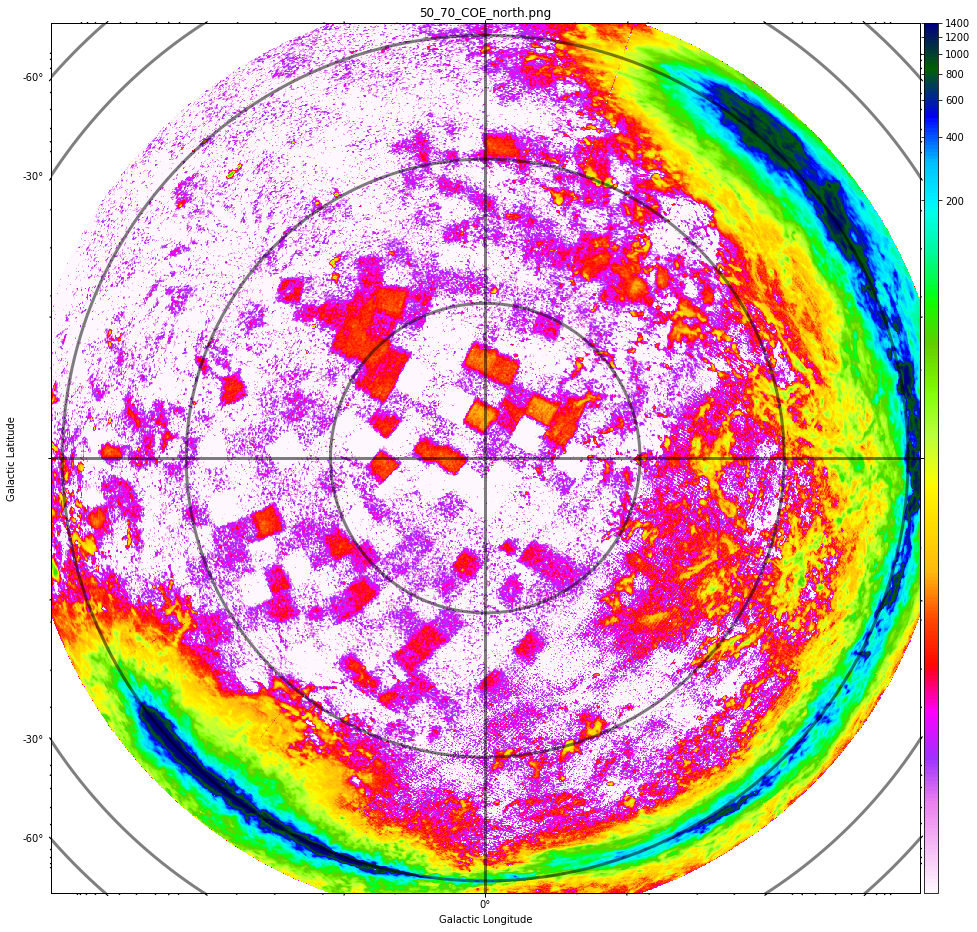

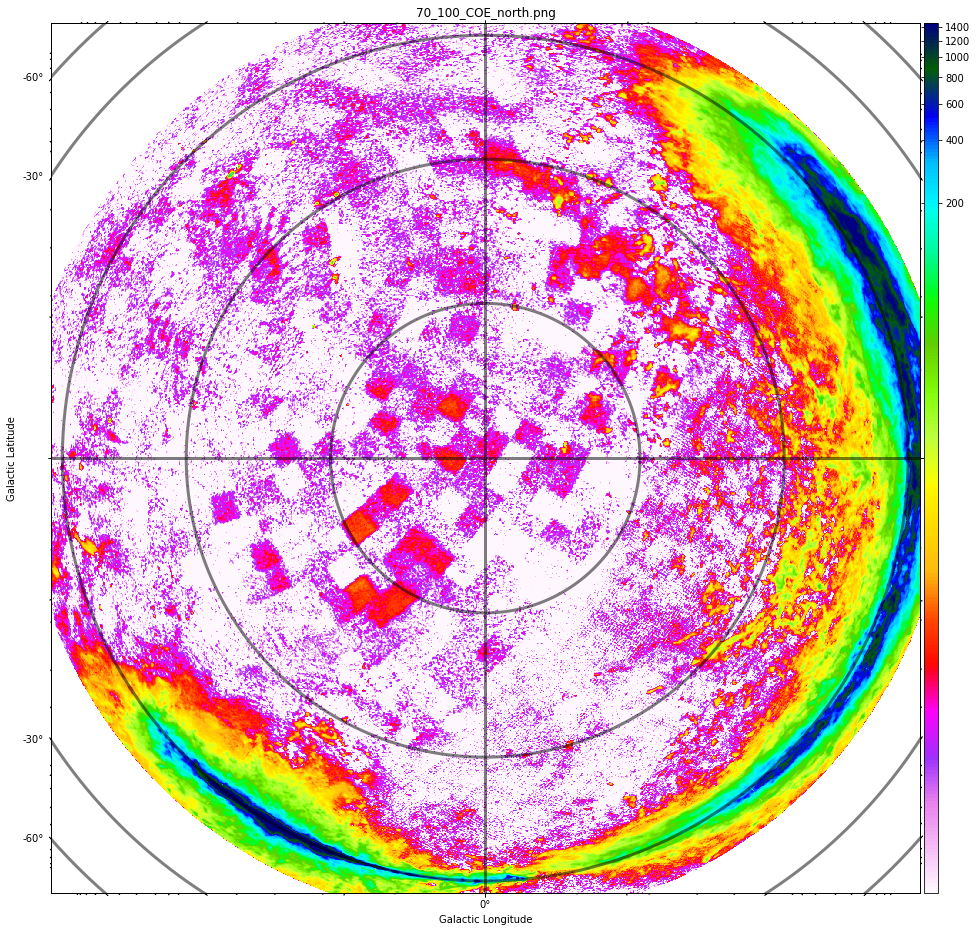

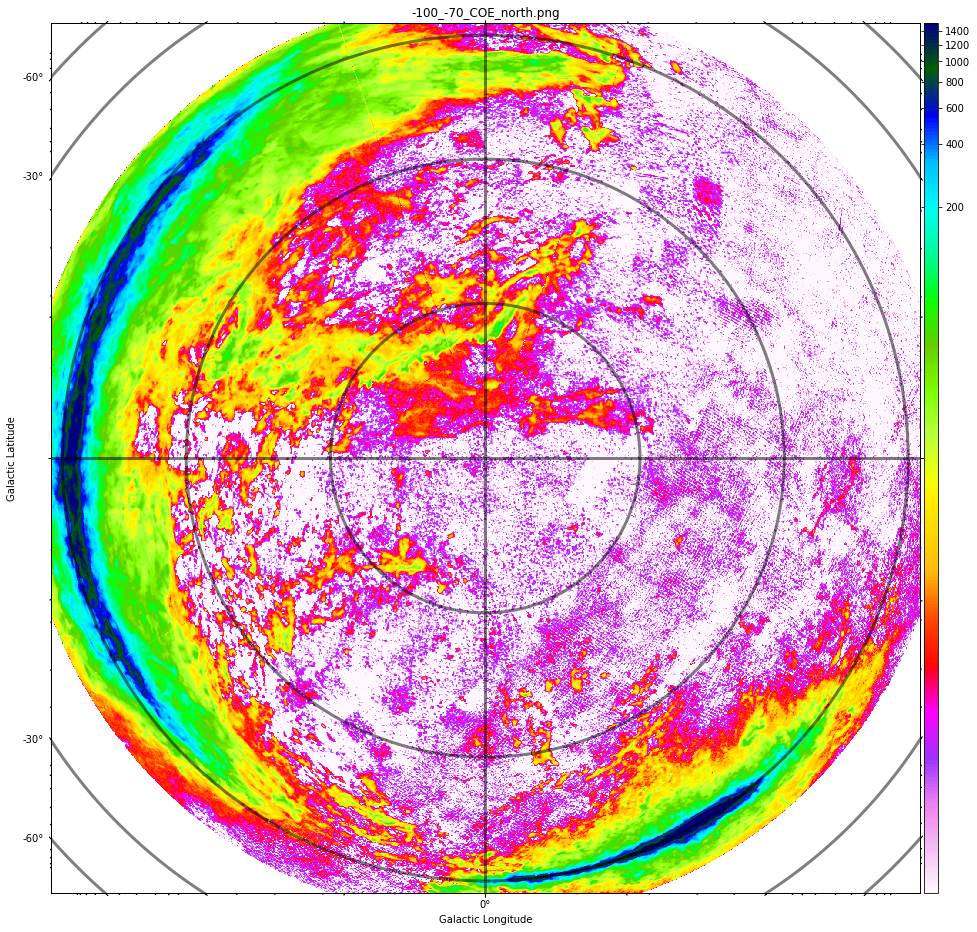

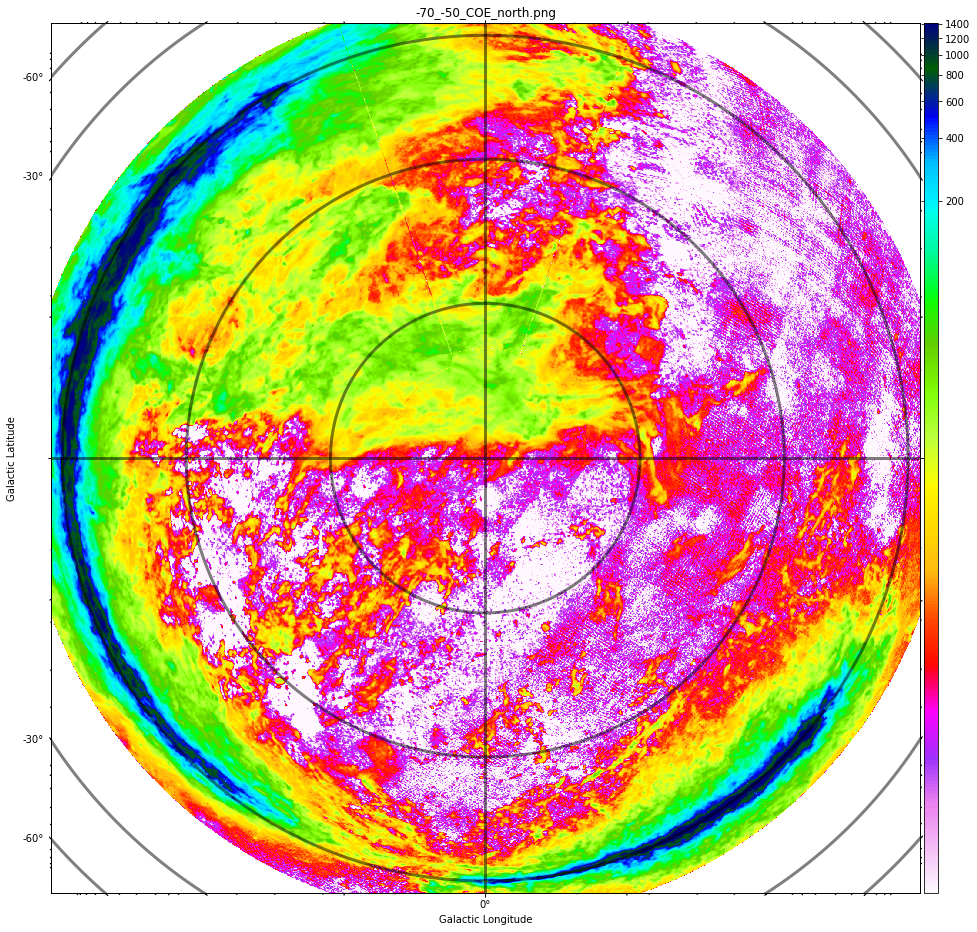

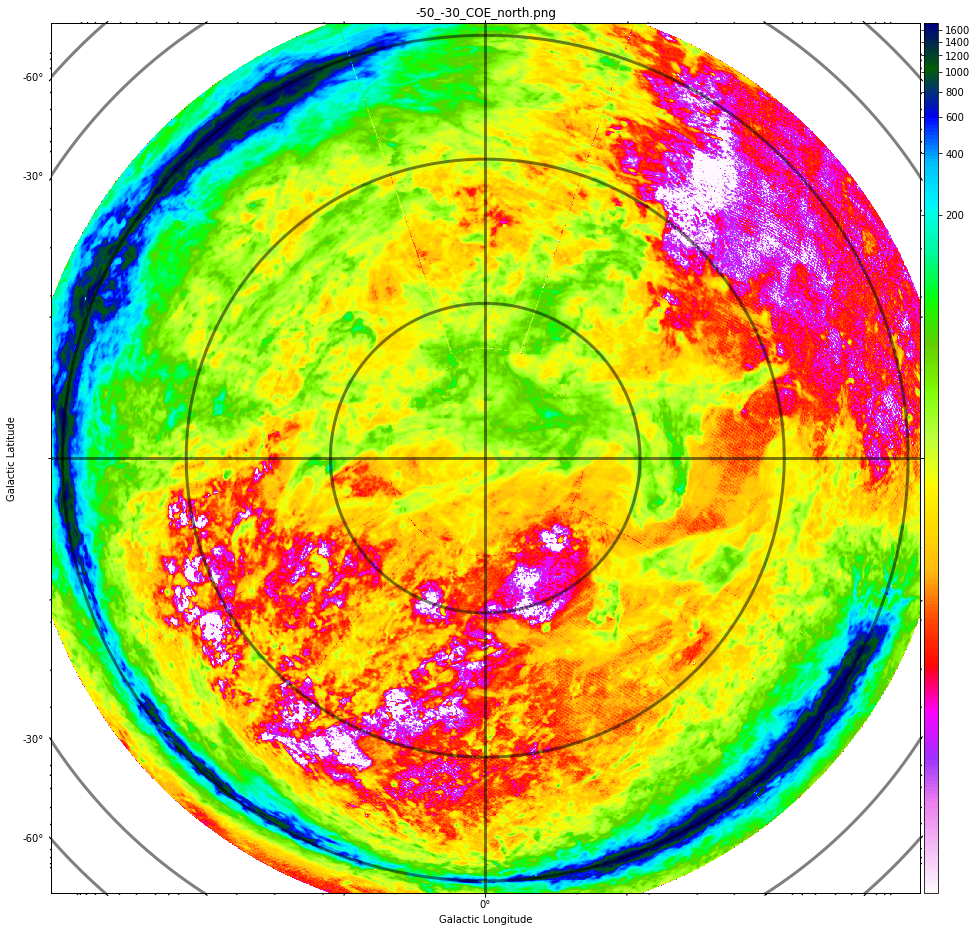

In [42]:
p_n_v = [[30,50],[50,70],[70,100],[-100,-70],[-70,-50],[-50,-30]]
for i in p_n_v:
    fig = plt.figure(figsize=(16,16))
    
    integ_hdu = make_new_hdu_integ(hdu, i[0], i[1], w)
    integ_hdu.writeto("/home/filament/Desktop/%i_%i_COE_north.fits"%(i[0],i[1]))
    F = aplpy.FITSFigure(integ_hdu,figure=fig)
    F.show_colorscale(vmin=0.1,stretch="log",cmap="gist_ncar_r")
    F.add_colorbar()
    F.add_grid()
    F.grid.set_linewidth(3)
    F.grid.set_color('k')
    F.set_title("%i_%i_COE_north.png"%(i[0],i[1]))
    F.save("/home/filament/Desktop/%i_%i_COE_north.png"%(i[0],i[1]))

south

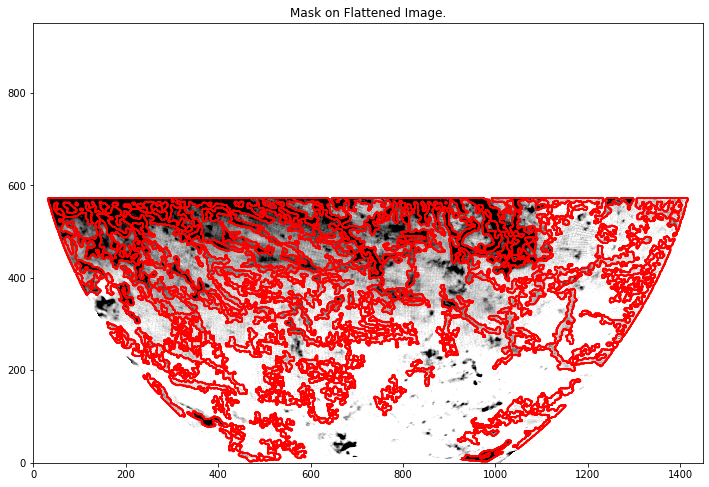

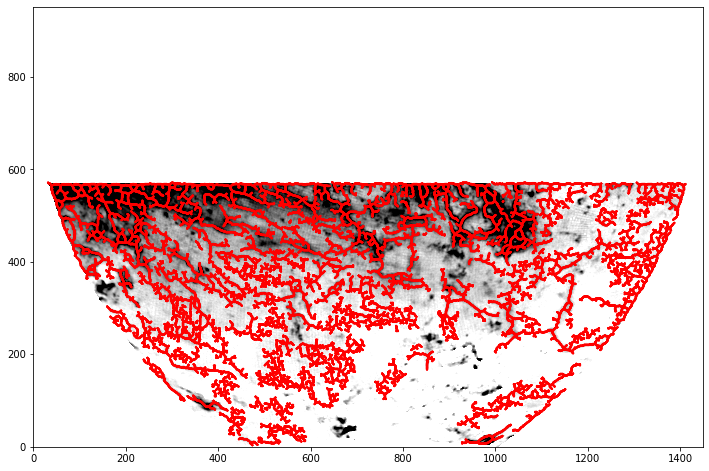

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

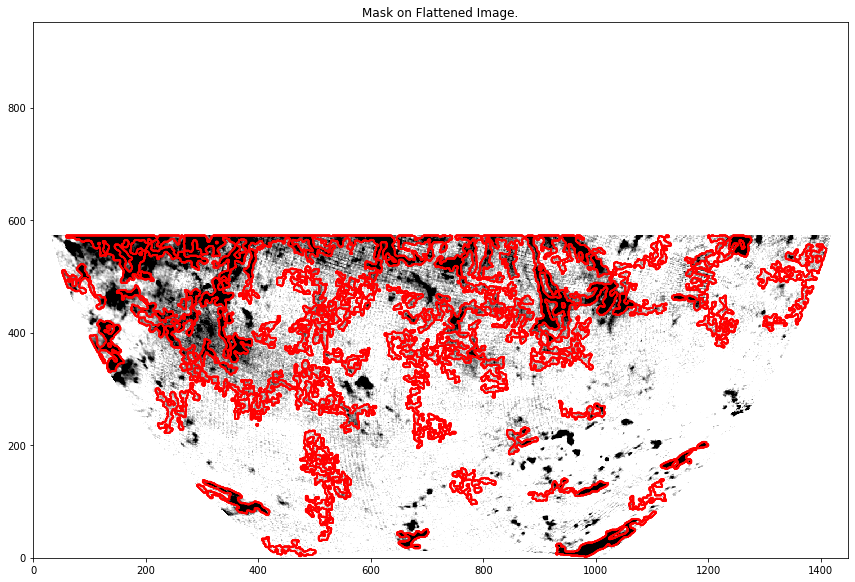

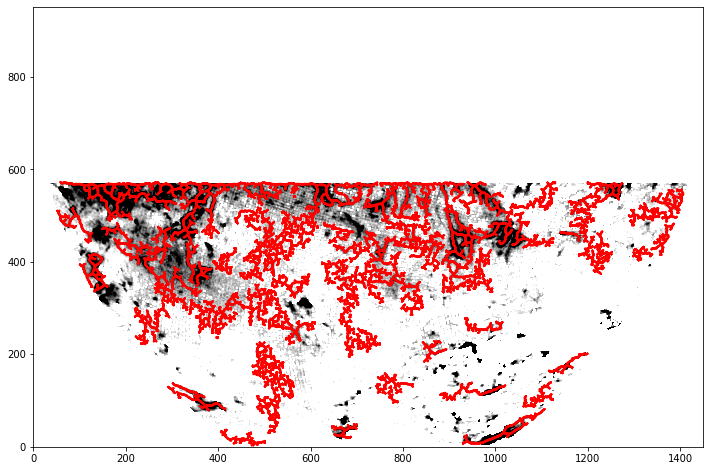

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

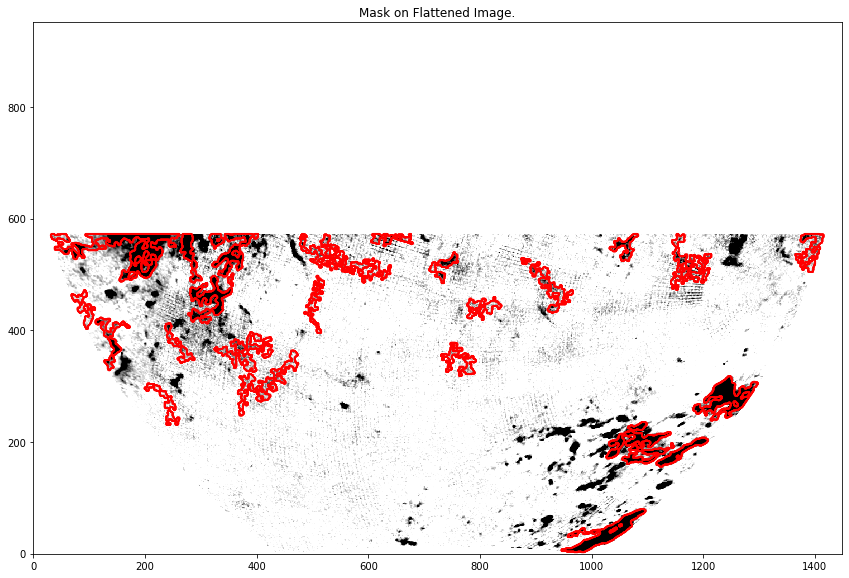

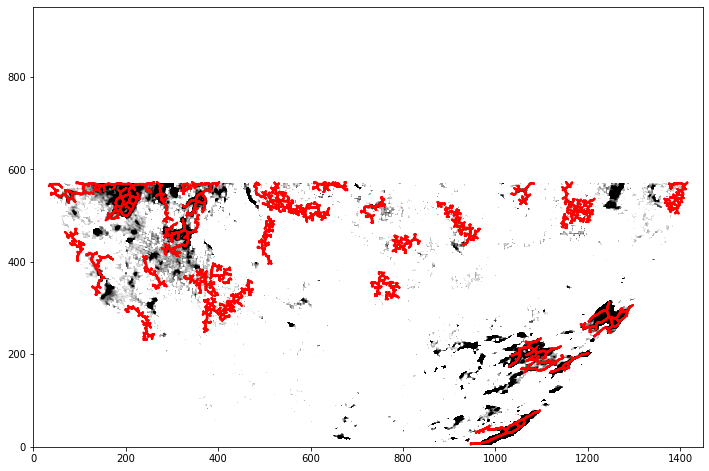

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

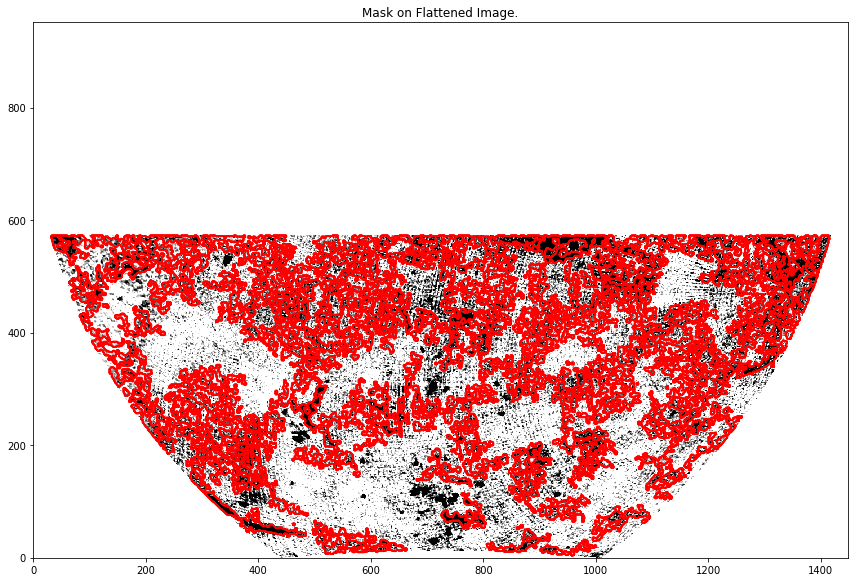

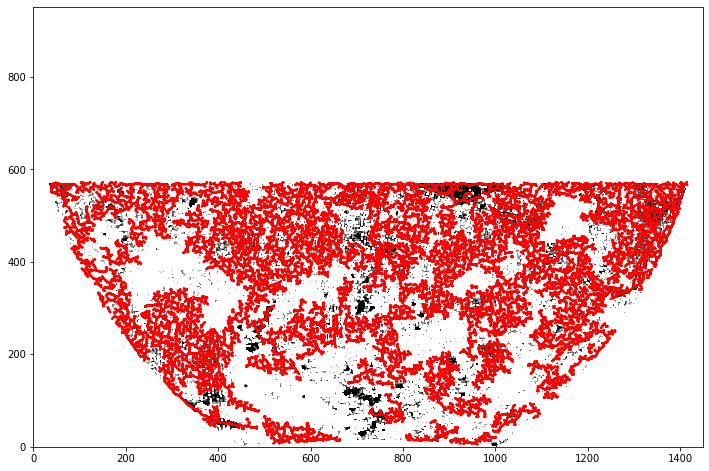

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

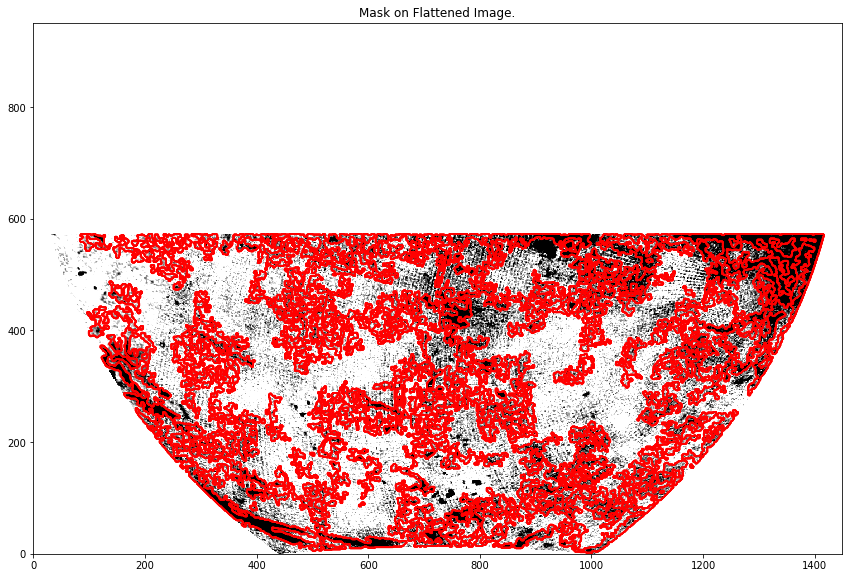

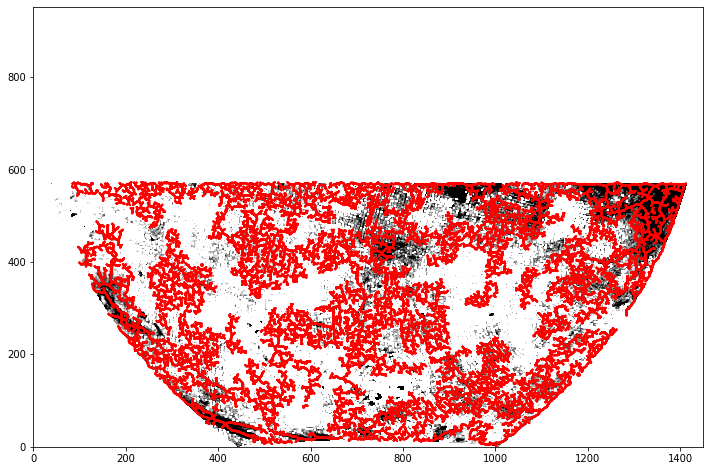

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/sit

<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

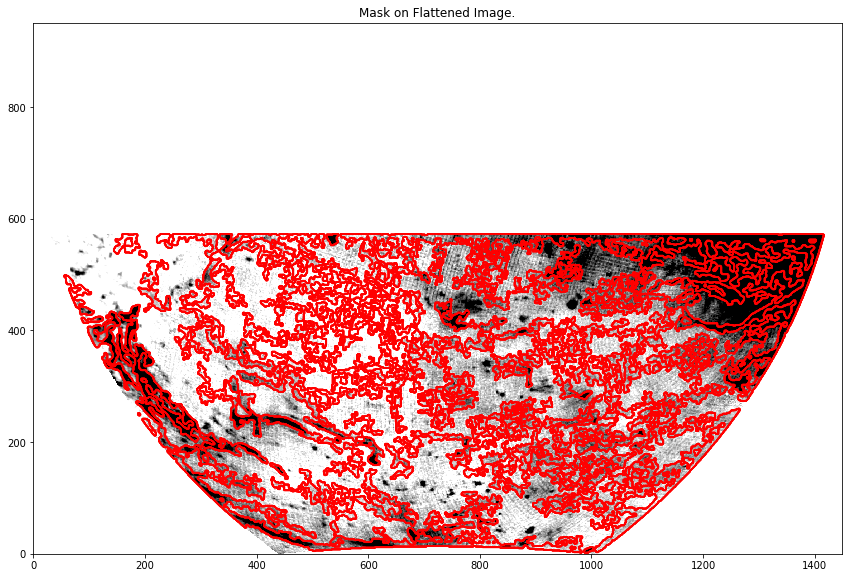

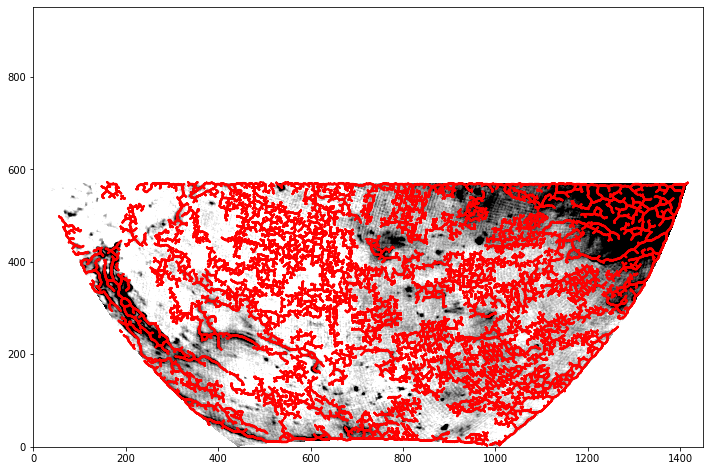

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:995: UserWarning: Width could not be deconvolved from the beam width.
  warnings.warn("Width could not be deconvolved from the beam "
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:217: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

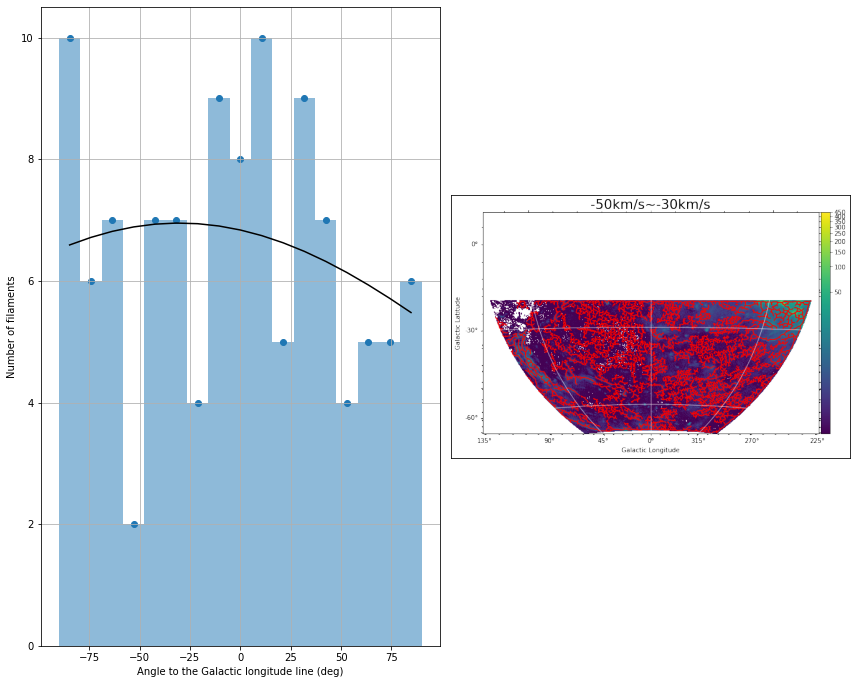

In [20]:
w = WCS(hdu)

fig_name = 0

if fits_pwd.split('/')[7].split('.')[0] == "test_1":
    fig_name = "region1"
elif fits_pwd.split('/')[7].split('.')[0] == "test_2":
    fig_name = "region2"
elif fits_pwd.split('/')[7].split('.')[0] == "test_3":
    fig_name = "region3"
elif fits_pwd.split('/')[7].split('.')[0] == "test_4":
    fig_name = "region4"
elif fits_pwd.split('/')[7].split('.')[0] == "test_5":
    fig_name = "region5"
elif fits_pwd.split('/')[7].split('.')[0] == "test_6":
    fig_name = "region6"


p_n_v = [[30,50],[50,70],[70,100],[-100,-70],[-70,-50],[-50,-30]]

# p_n_v = [[30,50]]

for i,j in enumerate(p_n_v):
    v_start,v_end,d,bmaj,cdelt,vmin,vmax = j[0],j[1],10,0.2706,0.083333333,1,450
    ##########################
    #     wcs = WCS(hdu.header)
    ##########################


    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan####0.01
    xpix_tempo,ypix_tempo,vpix_tempo = w.wcs_world2pix(0,-20,0,0)
    integ_hdu.data[int(ypix_tempo):,:]=np.nan
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
    #     hdr1["BPA"] = integ_hdu.header["BPA"]
    #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
    #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
    #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
    #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True,border_masking=False)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2

    fig = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig.add_colorbar()
    fig.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig.add_grid()
    
    plt.rcParams["font.size"] = 18
    
    fig.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
    fig.savefig("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/%s_%i_%i.png"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end))
    # integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
    
    plt.rcParams["font.size"] = 10
    integ_hdu.writeto("/home/filament/Desktop/fil-test/integ_fits/AIT/"+fig_name+"/"+fits_pwd.split('/')[7].split('.')[0]+"%i_%i.fits"%(v_start,v_end), overwrite=True)

    plt.clf()
    fil.analyze_skeletons()
#     fil.analyze_skeletons(nbeam_lengths=3, branch_nbeam_lengths=3, branch_thresh=10*u.pix, skel_thresh=10*u.pix, prune_criteria='all')
    fil.exec_rht()
    fil.find_widths(max_dist=10 * u.pix)

    ypos = np.array([f.position()[0].value for f in fil.filaments])


    lean_ls = []

    pa_deg_map = np.zeros(hdu.data.shape[1:])
    for i in range(hdu.data.shape[2]):
        for j in range(hdu.data.shape[1]):

            pos = w.wcs_pix2world(i,j,0,0)
            if np.isnan(pos[0])==True or np.isnan(pos[1])==True:
                lean_ls.append(0)
                pa_deg_map[[j],[i]]=np.nan
                continue
            slide_plus = np.array([pos[0],pos[1]+0.0001])
            slide_minus = np.array([pos[0],pos[1]-0.0001])
            slide_plus_pix = w.wcs_world2pix(slide_plus[0],slide_plus[1],0,0)
            slide_minus_pix = w.wcs_world2pix(slide_minus[0],slide_minus[1],0,0)
            vec = np.array(slide_plus_pix) - np.array(slide_minus_pix)
    #         vec = np.array([slide_plus_pix[0]-slide_minus_pix[0],slide_plus_pix[1]-slide_minus_pix[1]])
            lean = -vec[0]/vec[1]  #
    #         print(lean)
    #         print(np.arctan(lean))
            lean_ls.append(np.rad2deg(np.arctan(lean)))
            pa_deg_map[[j],[i]]=np.rad2deg(np.arctan(lean))


    fig = aplpy.FITSFigure(integ_hdu,slices=[0])

    plt.imshow(pa_deg_map)
    fig.add_grid()
    plt.colorbar()
    fig.ticks.set_xspacing(5)
    fig.ticks.set_yspacing(5)

    fil_ori_ = []
    fil_int = []
    for f in fil.filaments:
        pa = np.rad2deg(f.orientation.value)-pa_deg_map[int(f.position()[0].value)][int(f.position()[1].value)]
        fil_ori_.append(pa)
        fil_int.append(f.total_intensity())
    fil_ori_=np.array(fil_ori_)
    ypos = np.array([f.position()[0].value for f in fil.filaments])
    fil_ori_=np.where(fil_ori_<-90,fil_ori_+180,fil_ori_)
    fil_ori_=np.where(fil_ori_>90,fil_ori_-180,fil_ori_)
    # -90deg以下のものには+180deg、90deg以上のものには-180degをして±90degの範囲に収める。
    # plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))

    ##################################################
    a,b,c = plt.hist(fil_ori_,alpha=0.5,bins=np.linspace(-90,90,num=18))
    np.save("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/ori_%s_%i_%i.npy"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end),fil_ori_)
    np.save("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/tot_int_%s_%i_%i.npy"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end),fil_int)
    b_ls = []
    for i in range(len(b)-1):
        b_ls.append((b[i]+b[i+1])/2)

    def func(x, a, mu, sigma):
        return a*np.exp(-(x-mu)**2/(2*sigma**2))

    param_ini = [10,10,10]

    try:
        popt, pcov = curve_fit(func, b_ls, a,p0=param_ini,maxfev=1000)
        np.save("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/popt_%s_%i_%i.npy"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end),popt)
        np.save("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/pcov_%s_%i_%i.npy"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end),pcov)
    except RuntimeError:
        pass

    try:
        fitting = func(b_ls, popt[0],popt[1],popt[2])
    except NameError:
        pass
    ##################################################


    plt.clf()



    #確率分布のスケールを変える
    #確率分布に従って、全データ数と同じ数のサンプルを発生させたときの予測値をプロットする。このとき、プロットの x 座標にはヒストグラムの各ビンの中心を用いる。
    fig = plt.figure()
    ax1 = plt.subplot(1,2,1)
    ax2 = plt.subplot(1,2,2)

    # img = plt.imread("/home/filament/Downloads/fil_remake/"+fits_pwd.split('/')[7].split('.')[0]+"_"+str(v_start)+"_"+str(v_end)+".png")

    img = plt.imread("/home/filament/Desktop/fil-test/fil_finder.png/AIT/"+fig_name+"/%s_%i_%i.png"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end))

    plt.rcParams["font.size"] = 18
    # plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
    # plt.xlabel('Angle to the Galactic longitude line (deg)')
    # plt.ylabel('Number of filaments')


    # ax1.plot(b_mid,y) # ビンの中心に、確率分布から予想される高さをプロット
    ax1.scatter(b_ls,a)
    ax1.hist(fil_ori_,alpha=0.5,bins=np.linspace(-90,90,num=18))

    try:
        ax1.plot(b_ls,fitting,'k')
    except NameError:
        pass



    ax1.set_xlabel('Angle to the Galactic longitude line (deg)')
    ax1.set_ylabel('Number of filaments')


    # ax2.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
    # plt.xlabel('Angle to the Galactic longitude line (deg)')
    # plt.ylabel('Number of filaments')
    # ax2.set_xlabel('Angle to the Galactic longitude line (deg)')
    # ax2.set_ylabel('Number of filaments')

    ax2.imshow(img)
    ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)


    ax1.grid()
    # ax2.grid()
    plt.rcParams["font.size"] = 10
    #plt.showではなくfig.show()にしないとsubplotの場合はうまくsubplotで表示してくれない！！
    # plt.show
    fig.show()

    plt.tight_layout()


    plt.savefig("/home/filament/Desktop/fil-test/PA_gaussianfit/AIT/"+fig_name+"/"+fig_name+"_"+str(v_start)+"_"+str(v_end)+"_PA_gaussian.png")

(952, 1449)


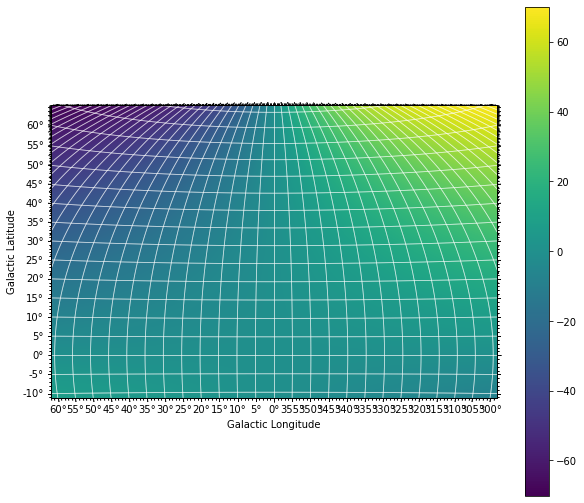

In [18]:
fig = aplpy.FITSFigure(integ_hdu,slices=[0])
print(pa_deg_map.shape)

plt.imshow(pa_deg_map)
fig.add_grid()
plt.colorbar()
fig.ticks.set_xspacing(5)
fig.ticks.set_yspacing(5)

TAN

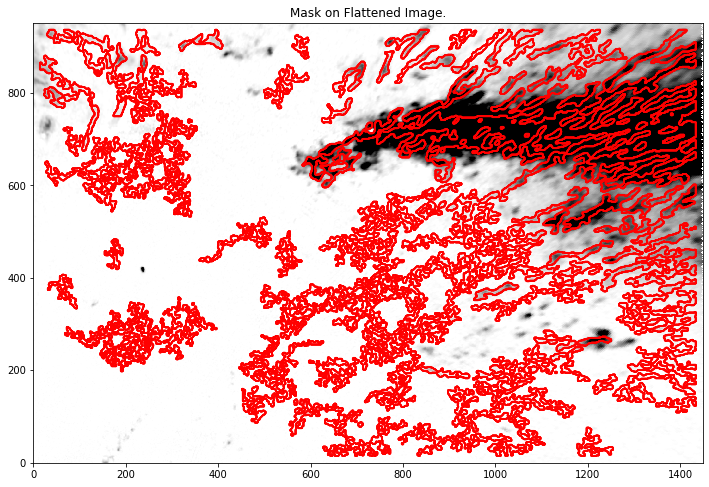

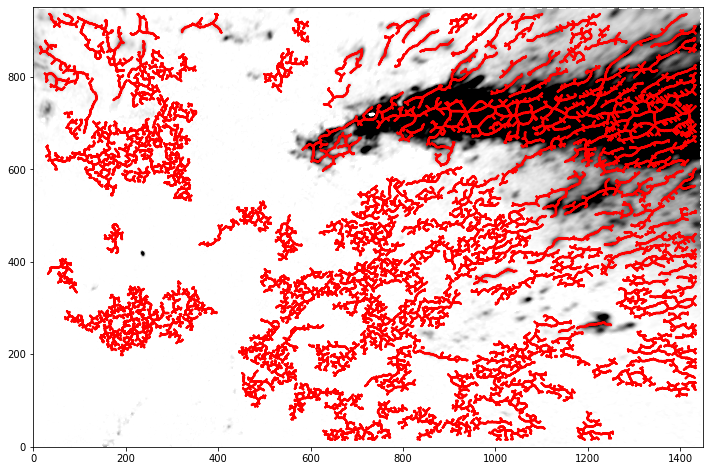

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:205: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

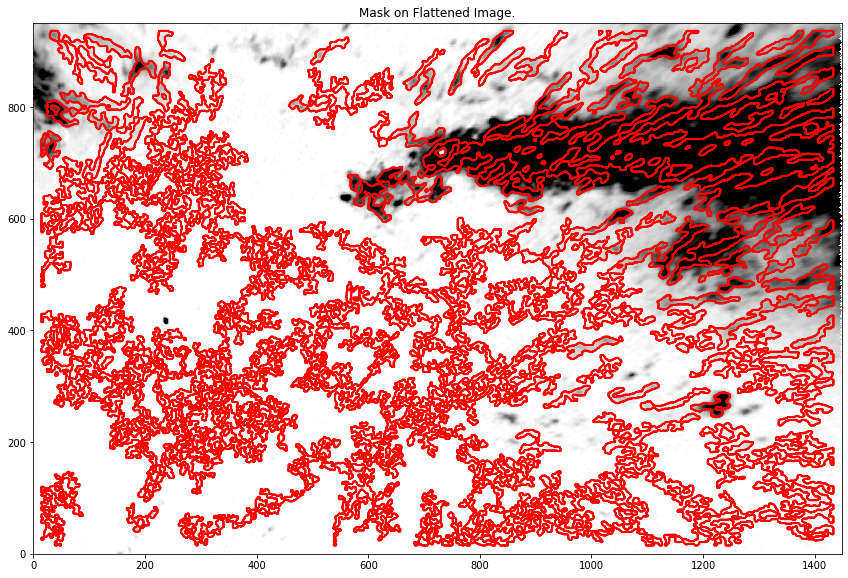

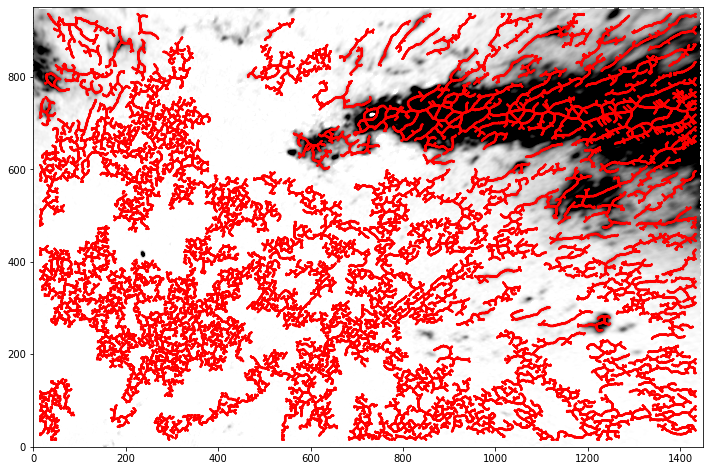

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:205: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

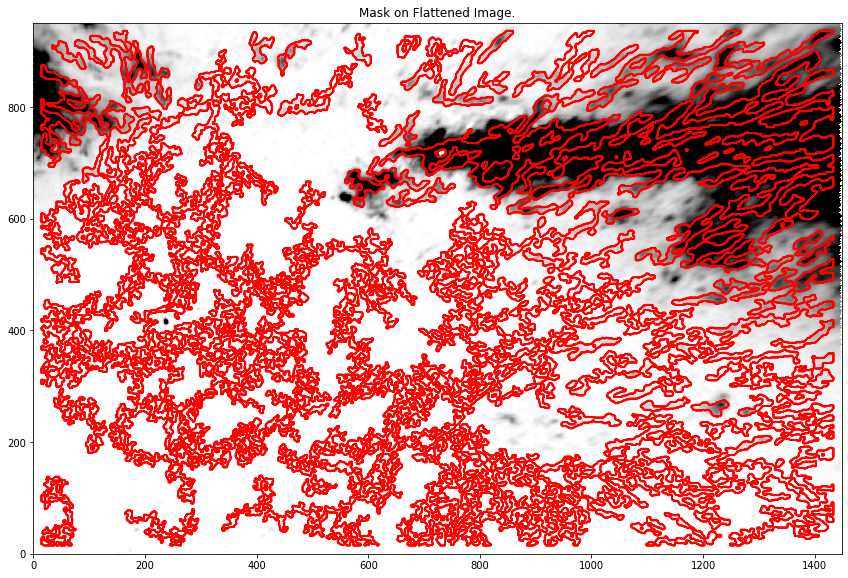

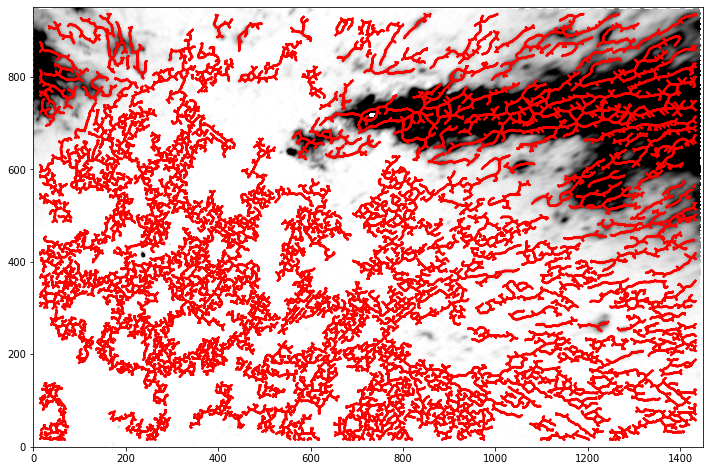

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:205: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

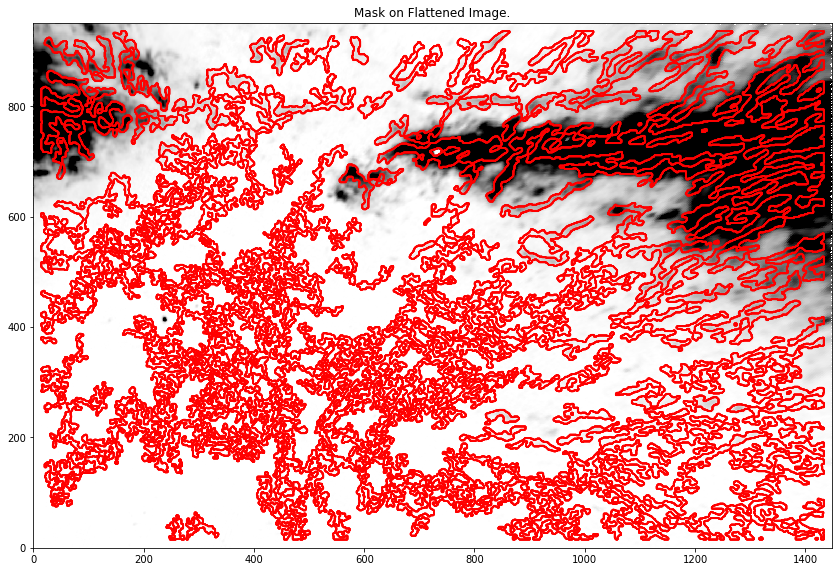

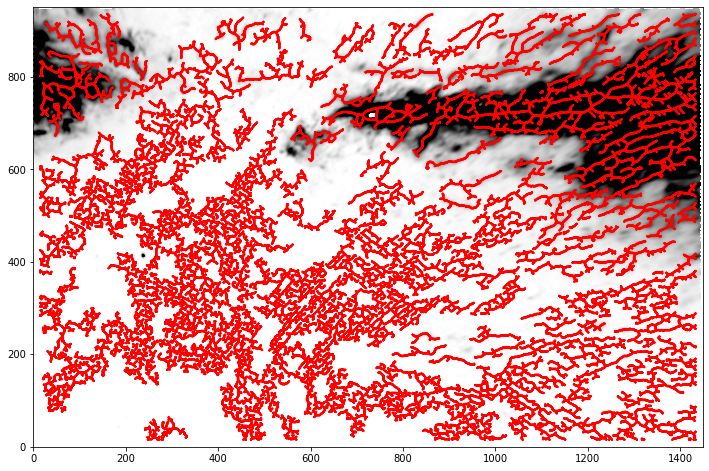

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:205: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

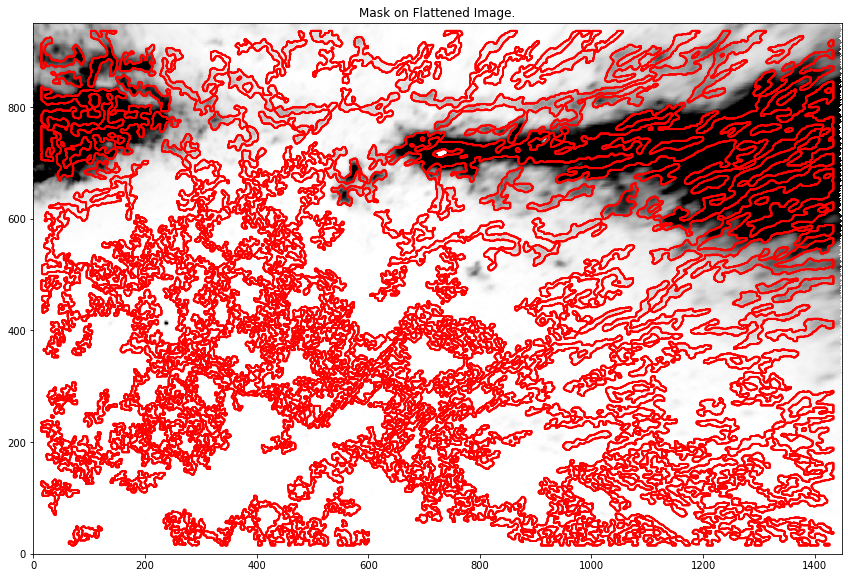

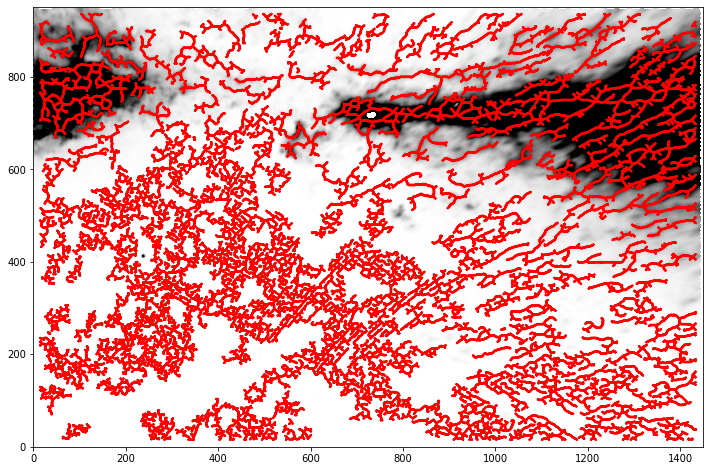

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:205: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

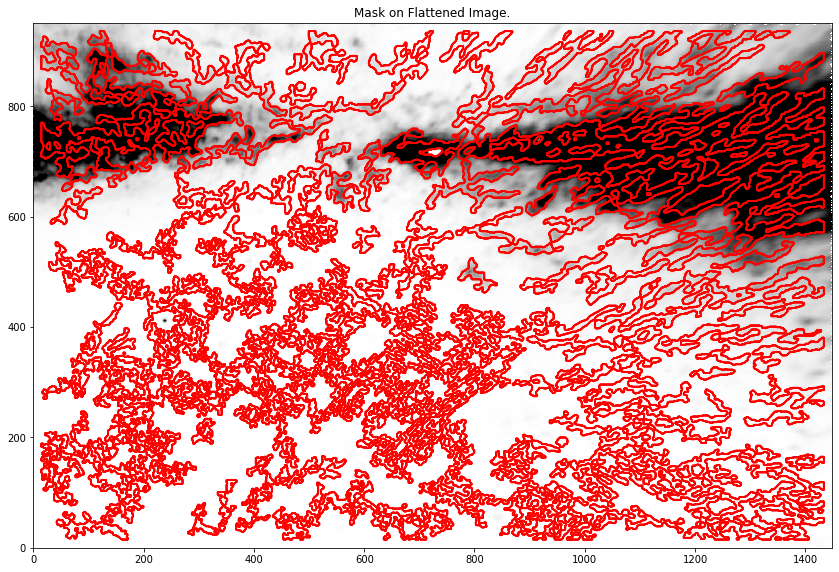

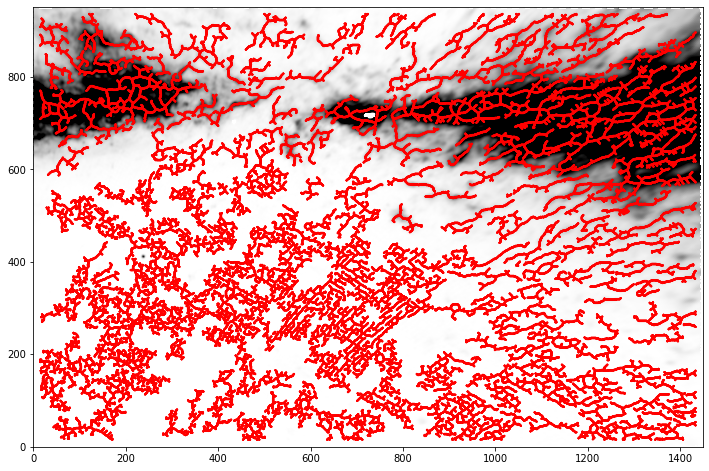

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:205: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

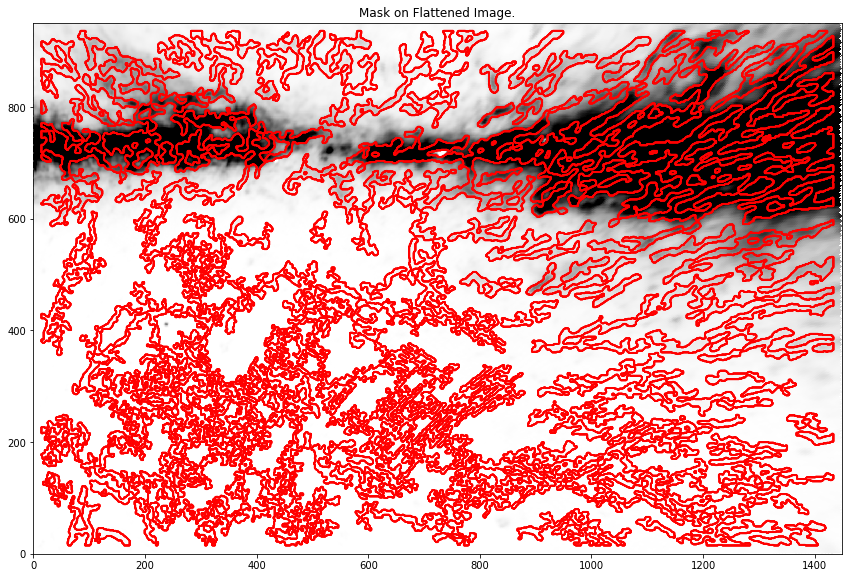

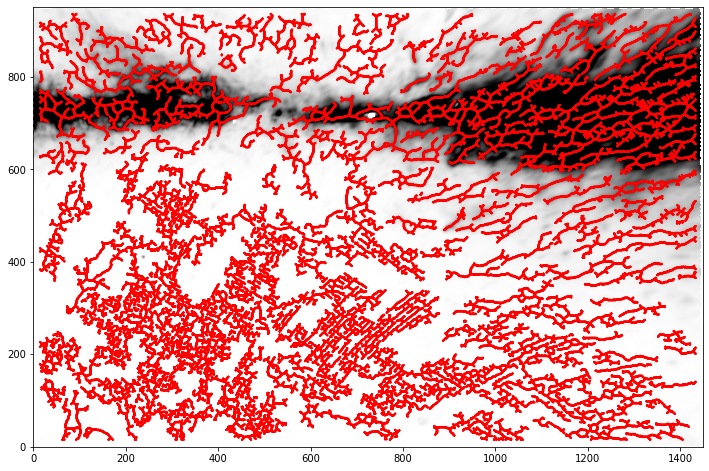

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:205: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

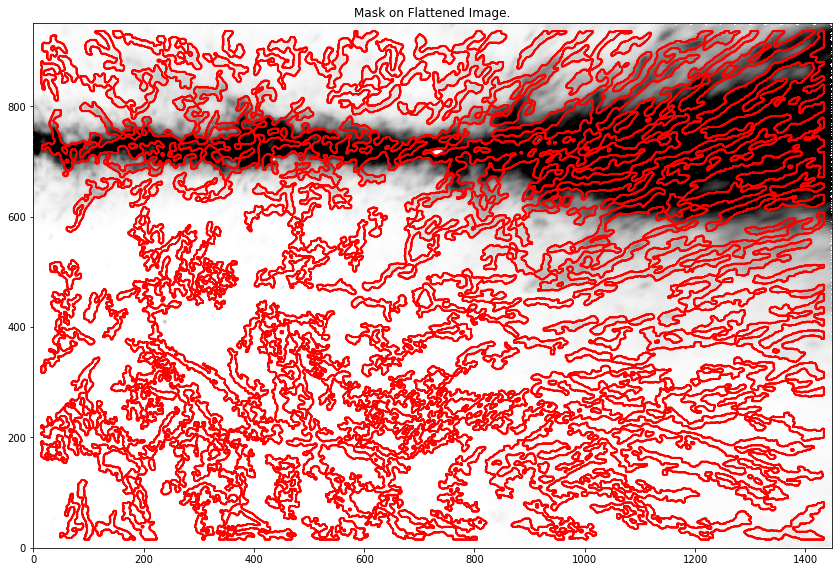

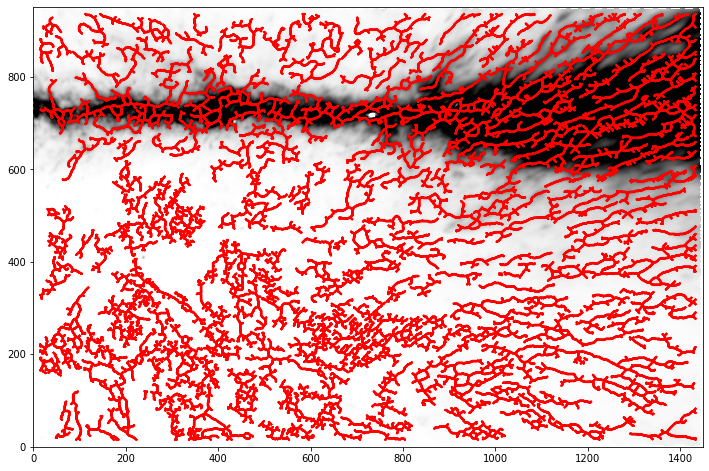

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:205: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

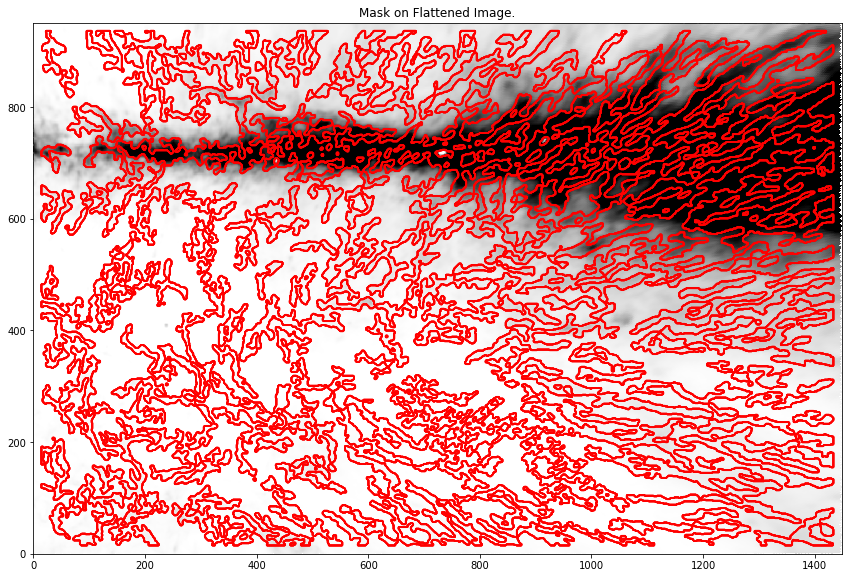

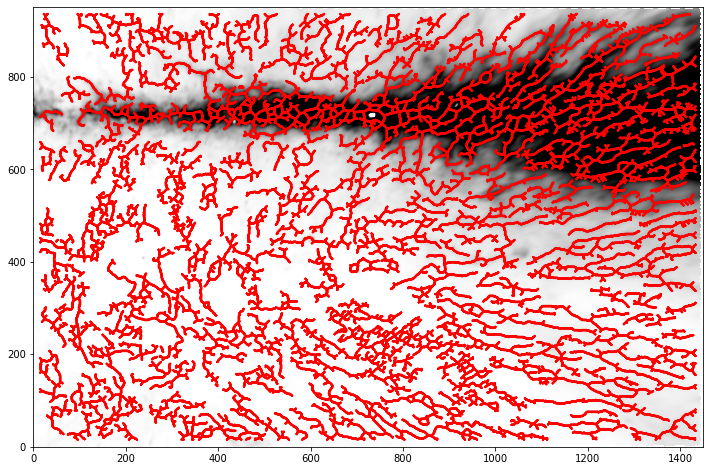

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:205: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

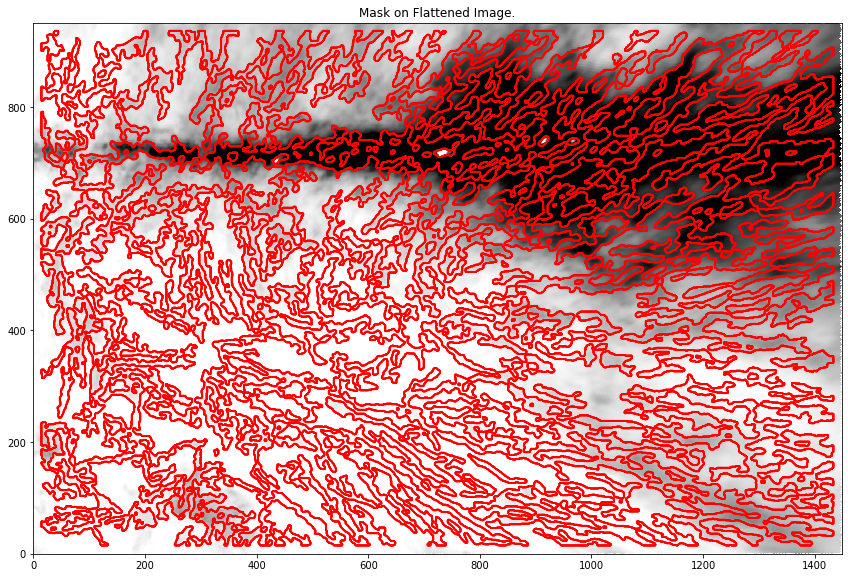

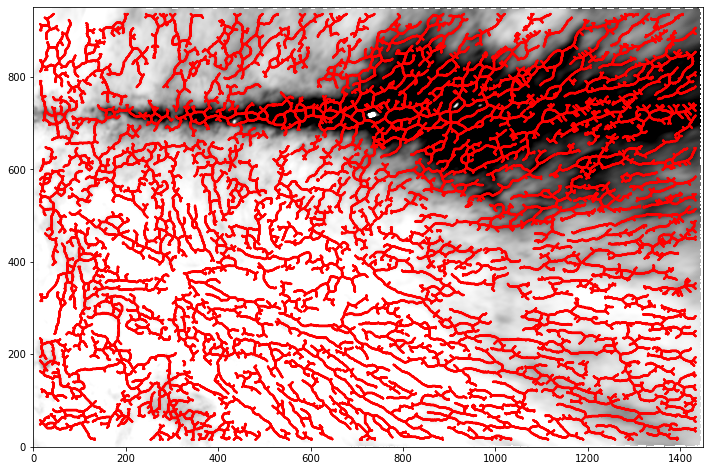

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:205: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


<Figure size 720x648 with 0 Axes>

<Figure size 720x648 with 0 Axes>

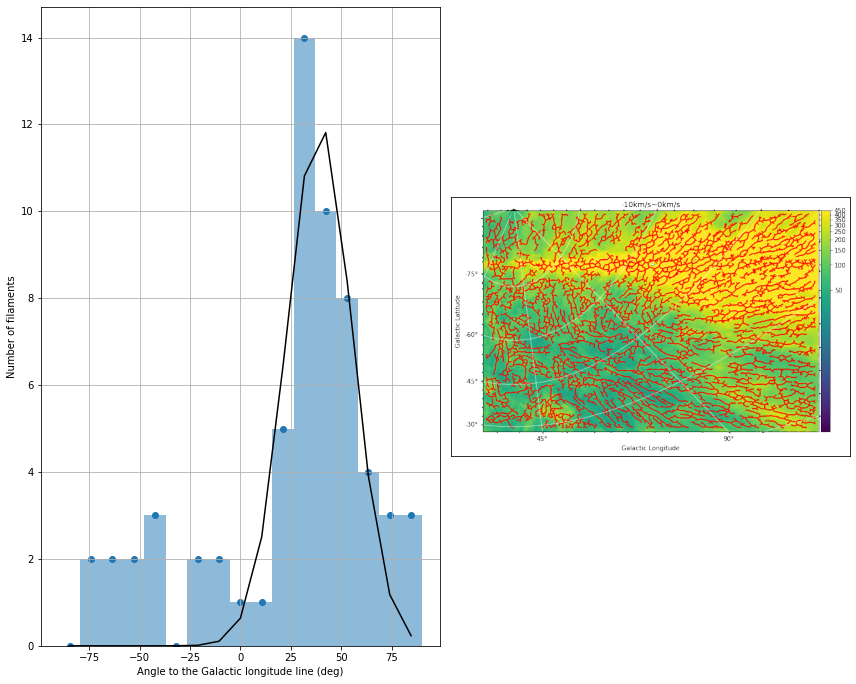

In [18]:
w = WCS(hdu)

fig_name = 0

if fits_pwd.split('/')[7].split('.')[0] == "test_1_TAN":
    fig_name = "region1"
elif fits_pwd.split('/')[7].split('.')[0] == "test_2_TAN":
    fig_name = "region2"
elif fits_pwd.split('/')[7].split('.')[0] == "test_3_TAN":
    fig_name = "region3"
elif fits_pwd.split('/')[7].split('.')[0] == "test_4_TAN":
    fig_name = "region4"
elif fits_pwd.split('/')[7].split('.')[0] == "test_5_TAN":
    fig_name = "region5"
elif fits_pwd.split('/')[7].split('.')[0] == "test_6_TAN":
    fig_name = "region6"


v_list_1_p = [[0,10],[10,20],[20,30],[30,40],[40,50],[50,60],[60,70],[70,80],[80,90],[90,100]]
v_list_1_n = [[-100,-90],[-90,-80],[-80,-70],[-70,-60],[-60,-50],[-50,-40],[-40,-30],[-30,-20],[-20,-10],[-10,0]]
v_list_2 = [[20,35],[35,50],[50.65],[65,80],[80,95],[95,110]]
v_list_3 = [[20,40],[40,60],[60,80],[80,100]]

for i,j in enumerate(v_list_1_n):
    v_start,v_end,d,bmaj,cdelt,vmin,vmax = j[0],j[1],10,0.2706,0.083333333,1,450
    ##########################
    #     wcs = WCS(hdu.header)
    ##########################


    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
    #     hdr1["BPA"] = integ_hdu.header["BPA"]
    #     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
    #     hdr1["BMIN"] = integ_hdu.header["BMIN"]
    #     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
    #     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2

    fig = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig.add_colorbar()
    fig.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig.add_grid()
    fig.set_title("%ikm/s~%ikm/s"%(v_start,v_end))
    fig.savefig("/home/filament/Desktop/fil-test/fil_finder.png/TAN/"+fig_name+"/%s_%i_%i.png"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end))
    # integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
    integ_hdu.writeto("/home/filament/Desktop/fil-test/integ_fits/TAN/"+fig_name+"/"+fits_pwd.split('/')[7].split('.')[0]+"%i_%i.fits"%(v_start,v_end), overwrite=True)

    plt.clf()

    fil.analyze_skeletons()
    fil.exec_rht()

    ypos = np.array([f.position()[0].value for f in fil.filaments])


    lean_ls = []

    pa_deg_map = np.zeros(hdu.data.shape[1:])
    for i in range(hdu.data.shape[2]):
        for j in range(hdu.data.shape[1]):

            pos = w.wcs_pix2world(i,j,0,0)
            if np.isnan(pos[0])==True or np.isnan(pos[1])==True:
                lean_ls.append(0)
                pa_deg_map[[j],[i]]=np.nan
                continue
            slide_plus = np.array([pos[0],pos[1]+0.0001])
            slide_minus = np.array([pos[0],pos[1]-0.0001])
            slide_plus_pix = w.wcs_world2pix(slide_plus[0],slide_plus[1],0,0)
            slide_minus_pix = w.wcs_world2pix(slide_minus[0],slide_minus[1],0,0)
            vec = np.array(slide_plus_pix) - np.array(slide_minus_pix)
    #         vec = np.array([slide_plus_pix[0]-slide_minus_pix[0],slide_plus_pix[1]-slide_minus_pix[1]])
            lean = -vec[0]/vec[1]  #
    #         print(lean)
    #         print(np.arctan(lean))
            lean_ls.append(np.rad2deg(np.arctan(lean)))
            pa_deg_map[[j],[i]]=np.rad2deg(np.arctan(lean))


    fig = aplpy.FITSFigure(integ_hdu,slices=[0])

    plt.imshow(pa_deg_map)
    fig.add_grid()
    plt.colorbar()
    fig.ticks.set_xspacing(5)
    fig.ticks.set_yspacing(5)

    fil_ori_ = []
    for f in fil.filaments:
        pa = np.rad2deg(f.orientation.value)-pa_deg_map[int(f.position()[0].value)][int(f.position()[1].value)]
        fil_ori_.append(pa)
    fil_ori_=np.array(fil_ori_)
    ypos = np.array([f.position()[0].value for f in fil.filaments])
    fil_ori_=np.where(fil_ori_<-90,fil_ori_+180,fil_ori_)
    fil_ori_=np.where(fil_ori_>90,fil_ori_-180,fil_ori_)
    # -90deg以下のものには+180deg、90deg以上のものには-180degをして±90degの範囲に収める。
    # plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))

    ##################################################
    a,b,c = plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))

    b_ls = []
    for i in range(len(b)-1):
        b_ls.append((b[i]+b[i+1])/2)

    def func(x, a, mu, sigma):
        return a*np.exp(-(x-mu)**2/(2*sigma**2))

    param_ini = [10,10,10]

    try:
        popt, pcov = curve_fit(func, b_ls, a,p0=param_ini,maxfev=1000)
    except RuntimeError:
        pass

    try:
        fitting = func(b_ls, popt[0],popt[1],popt[2])
    except NameError:
        pass
    ##################################################


    plt.clf()



    #確率分布のスケールを変える
    #確率分布に従って、全データ数と同じ数のサンプルを発生させたときの予測値をプロットする。このとき、プロットの x 座標にはヒストグラムの各ビンの中心を用いる。
    fig = plt.figure()
    ax1 = plt.subplot(1,2,1)
    ax2 = plt.subplot(1,2,2)

    # img = plt.imread("/home/filament/Downloads/fil_remake/"+fits_pwd.split('/')[7].split('.')[0]+"_"+str(v_start)+"_"+str(v_end)+".png")

    img = plt.imread("/home/filament/Desktop/fil-test/fil_finder.png/TAN/"+fig_name+"/%s_%i_%i.png"%(fits_pwd.split('/')[7].split('.')[0],v_start,v_end))

    plt.rcParams["font.size"] = 18
    # plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
    # plt.xlabel('Angle to the Galactic longitude line (deg)')
    # plt.ylabel('Number of filaments')


    # ax1.plot(b_mid,y) # ビンの中心に、確率分布から予想される高さをプロット
    ax1.scatter(b_ls,a)
    ax1.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))

    try:
        ax1.plot(b_ls,fitting,'k')
    except NameError:
        pass



    ax1.set_xlabel('Angle to the Galactic longitude line (deg)')
    ax1.set_ylabel('Number of filaments')


    # ax2.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
    # plt.xlabel('Angle to the Galactic longitude line (deg)')
    # plt.ylabel('Number of filaments')
    # ax2.set_xlabel('Angle to the Galactic longitude line (deg)')
    # ax2.set_ylabel('Number of filaments')

    ax2.imshow(img)
    ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)


    ax1.grid()
    # ax2.grid()
    plt.rcParams["font.size"] = 10
    #plt.showではなくfig.show()にしないとsubplotの場合はうまくsubplotで表示してくれない！！
    # plt.show
    fig.show()

    plt.tight_layout()


    plt.savefig("/home/filament/Desktop/fil-test/PA_gaussianfit/TAN/"+fig_name+"/"+fig_name+"_"+str(v_start)+"_"+str(v_end)+"_PA_gaussian.png")

CAR

In [36]:
ypos = np.array([f.position()[0].value for f in fil.filaments])

In [37]:
fil_ori_

array([-1.07306827e+01,  2.59086440e+01, -3.35558975e+00,  3.34507782e+01,
        6.48785021e+00, -7.07224076e+00,  1.09683132e+00, -2.34093052e+01,
       -5.96997095e+01,  9.95159161e+00,  1.42278982e+01, -7.05868227e+00,
       -1.77433667e+01, -1.36025034e+01, -2.21132807e+01, -1.61748147e+00,
       -3.72806925e+00, -1.62852137e+01, -3.43080362e+01, -1.24079382e+01,
       -2.06727599e+01,  2.15895081e+00, -2.43716642e+01, -1.93867995e+00,
       -2.29405880e+01, -4.78162992e+01, -3.44746250e+01, -3.37244383e+01,
       -2.99900495e+01,  7.77554505e-01, -2.45837140e+01, -2.88563486e+01,
       -3.19299395e+01, -4.31542159e+01, -7.78975109e+00, -1.23976918e+01,
       -1.03268016e+01, -3.41732326e+01,  6.44330467e+01,  7.97361996e+01,
        1.31319391e+00, -1.43060452e+01, -9.20544803e+00, -2.72026049e+01,
       -2.05950544e+00, -4.73598881e+01, -1.57082909e+01,  1.27789452e+01,
       -5.86912118e+00, -3.41815589e+01, -1.61508515e+01, -1.80006464e+01,
       -9.32120697e+00, -

In [38]:
fil_ori_[ypos>400]

array([-9.20544803e+00, -2.05950544e+00,  1.27789452e+01, -3.41815589e+01,
       -1.61508515e+01, -9.32120697e+00, -2.68684802e+01,  5.82490469e+00,
       -1.26977005e+01, -5.01485294e+01,  7.93074660e+00, -1.00373024e+01,
       -2.38996414e+01,  8.57999137e+00, -4.58909220e+01, -3.22708220e+01,
       -3.60793221e+01, -1.40957694e+00, -5.33386261e+01, -8.44224451e+00,
       -1.03476931e+01, -3.42790084e+00,  1.07710714e+01, -2.62421298e+01,
       -6.62609188e+00, -1.87082265e+01, -2.37180677e+01, -1.50466157e+01,
       -1.38858130e+01, -1.48227538e+01, -3.56180478e+00, -1.72794153e+01,
       -3.37715828e-01, -4.23207954e+01, -1.87469231e+01, -6.38819339e+01,
       -1.53565585e+01, -2.22963255e+01, -7.22400686e+01,  1.67174058e+00,
       -4.38616437e+01, -6.29671272e+01, -2.23635242e+01, -1.14935495e+01,
        6.43076514e+01, -5.71213139e+01, -2.82655336e+01, -2.02343431e+01,
       -3.08425905e+01, -8.81724174e+00, -3.55611815e+01, -5.21984768e+01,
       -9.70547534e+00, -

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:28: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


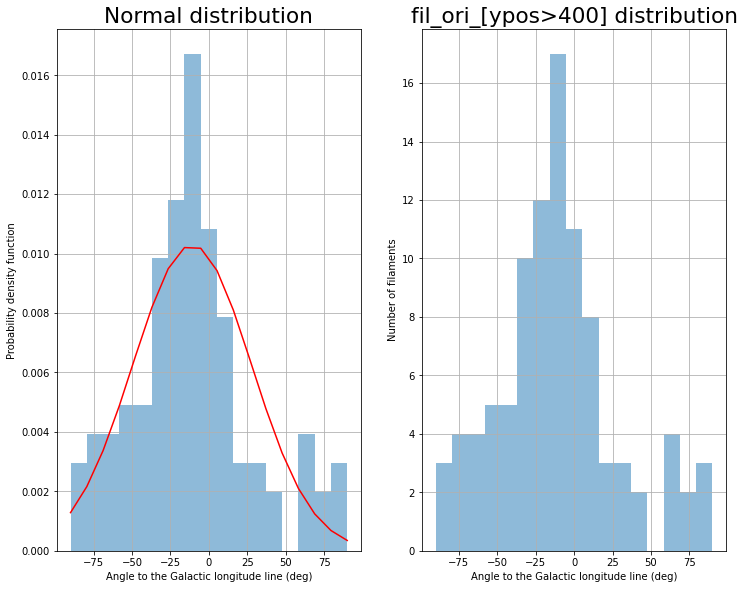

In [39]:
#ヒストグラムのスケールを変える
#ヒストグラムを確率密度関数に変換するため（？）、ヒストグラムの高さをすべてのデータ数で割る。
fig = plt.figure()
ax1 = plt.subplot(1,2,1)
ax2 = plt.subplot(1,2,2)
plt.rcParams["font.size"] = 18
param = norm.fit(fil_ori_[ypos>400])
x = np.linspace(-90,90,18)
pdf_fitted = norm.pdf(x,loc=param[0], scale=param[1])
pdf = norm.pdf(x)

# ax1.title('Normal distribution')
ax1.set_title('Normal distribution')
ax1.plot(x, pdf_fitted, 'r-')
# plt.plot(x, pdf, "b_")
# plt.hist(sample, normed=1, alpha=.3)
ax1.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18),density=True)
ax1.set_xlabel('Angle to the Galactic longitude line (deg)')
ax1.set_ylabel('Probability density function')

ax2.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
ax2.set_title("fil_ori_[ypos>400] distribution")
ax2.set_xlabel('Angle to the Galactic longitude line (deg)')
ax2.set_ylabel('Number of filaments')

#plt.showではなくfig.show()にしないとsubplotの場合はうまくsubplotで表示してくれない！！
# plt.show()  
fig.show()
ax1.grid()
ax2.grid()
plt.rcParams["font.size"] = 10

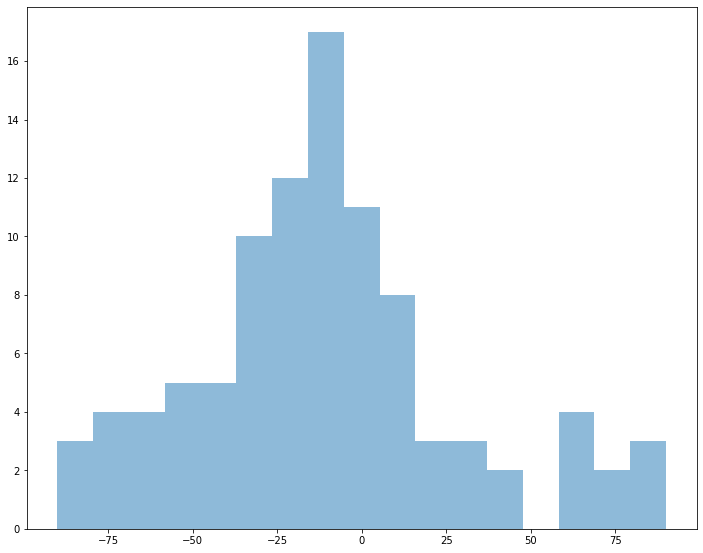

In [40]:
a,b,c = plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))

In [41]:
len(a)

17

In [42]:
b

array([-90.        , -79.41176471, -68.82352941, -58.23529412,
       -47.64705882, -37.05882353, -26.47058824, -15.88235294,
        -5.29411765,   5.29411765,  15.88235294,  26.47058824,
        37.05882353,  47.64705882,  58.23529412,  68.82352941,
        79.41176471,  90.        ])

In [43]:
b[:-1]

array([-90.        , -79.41176471, -68.82352941, -58.23529412,
       -47.64705882, -37.05882353, -26.47058824, -15.88235294,
        -5.29411765,   5.29411765,  15.88235294,  26.47058824,
        37.05882353,  47.64705882,  58.23529412,  68.82352941,
        79.41176471])

In [44]:
b_ls = []
for i in range(len(b)-1):
    b_ls.append((b[i]+b[i+1])/2)

In [45]:
b_ls = np.array(b_ls)
len(b_ls)

17

In [46]:
def func(x, a, mu, sigma):
    return a*np.exp(-(x-mu)**2/(2*sigma**2))

In [47]:
param_ini = [80,100,5]
popt, pcov = curve_fit(func, b[:-1], a)
print(popt)
fitting = func(b[:-1], popt[0],popt[1],popt[2])

[ 13.42421559 -19.85310932  26.00934031]


In [48]:
param_ini = [10,10,10]
popt, pcov = curve_fit(func, b_ls, a,p0=param_ini)
print(popt)
fitting = func(b_ls, popt[0],popt[1],popt[2])

[ 13.42368519 -14.55959539  26.01139644]


In [49]:
a,b

(array([ 3.,  4.,  4.,  5.,  5., 10., 12., 17., 11.,  8.,  3.,  3.,  2.,
         0.,  4.,  2.,  3.]),
 array([-90.        , -79.41176471, -68.82352941, -58.23529412,
        -47.64705882, -37.05882353, -26.47058824, -15.88235294,
         -5.29411765,   5.29411765,  15.88235294,  26.47058824,
         37.05882353,  47.64705882,  58.23529412,  68.82352941,
         79.41176471,  90.        ]))

In [50]:
fil_ori_[ypos>400]

array([-9.20544803e+00, -2.05950544e+00,  1.27789452e+01, -3.41815589e+01,
       -1.61508515e+01, -9.32120697e+00, -2.68684802e+01,  5.82490469e+00,
       -1.26977005e+01, -5.01485294e+01,  7.93074660e+00, -1.00373024e+01,
       -2.38996414e+01,  8.57999137e+00, -4.58909220e+01, -3.22708220e+01,
       -3.60793221e+01, -1.40957694e+00, -5.33386261e+01, -8.44224451e+00,
       -1.03476931e+01, -3.42790084e+00,  1.07710714e+01, -2.62421298e+01,
       -6.62609188e+00, -1.87082265e+01, -2.37180677e+01, -1.50466157e+01,
       -1.38858130e+01, -1.48227538e+01, -3.56180478e+00, -1.72794153e+01,
       -3.37715828e-01, -4.23207954e+01, -1.87469231e+01, -6.38819339e+01,
       -1.53565585e+01, -2.22963255e+01, -7.22400686e+01,  1.67174058e+00,
       -4.38616437e+01, -6.29671272e+01, -2.23635242e+01, -1.14935495e+01,
        6.43076514e+01, -5.71213139e+01, -2.82655336e+01, -2.02343431e+01,
       -3.08425905e+01, -8.81724174e+00, -3.55611815e+01, -5.21984768e+01,
       -9.70547534e+00, -

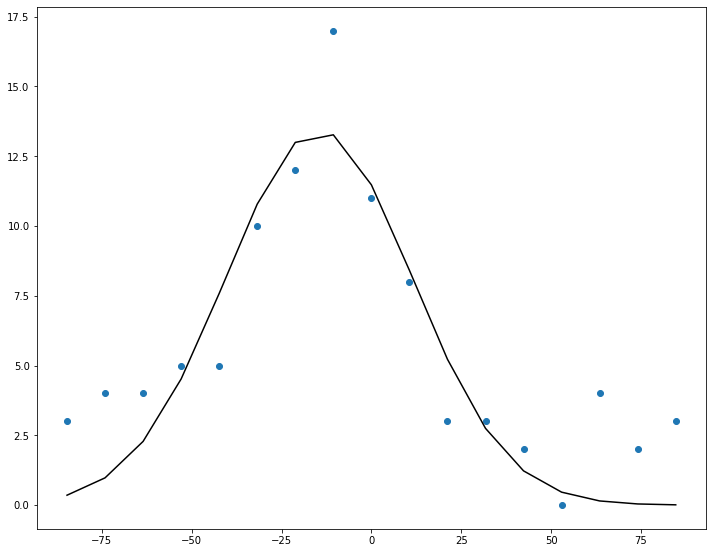

In [51]:
plt.scatter(b_ls,a)
plt.plot(b_ls,fitting,'k')


/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


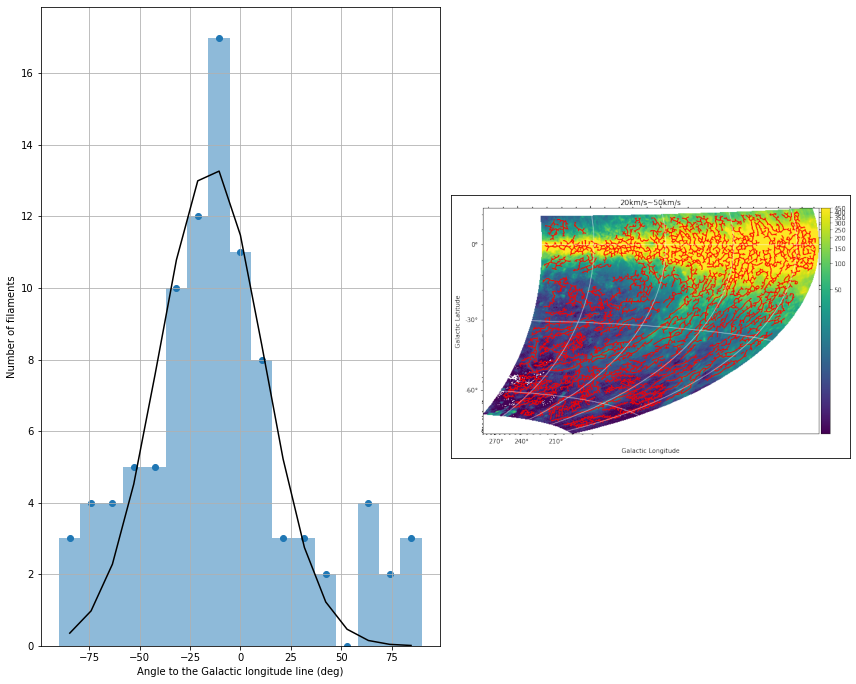

In [64]:
#確率分布のスケールを変える
#確率分布に従って、全データ数と同じ数のサンプルを発生させたときの予測値をプロットする。このとき、プロットの x 座標にはヒストグラムの各ビンの中心を用いる。
fig = plt.figure()
ax1 = plt.subplot(1,2,1)
ax2 = plt.subplot(1,2,2)

img = plt.imread("/home/filament/Downloads/fil_remake/test_2_20_50.png")


plt.rcParams["font.size"] = 18
# plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
# plt.xlabel('Angle to the Galactic longitude line (deg)')
# plt.ylabel('Number of filaments')


# ax1.plot(b_mid,y) # ビンの中心に、確率分布から予想される高さをプロット
ax1.scatter(b_ls,a)
ax1.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
ax1.plot(b_ls,fitting,'k')



ax1.set_xlabel('Angle to the Galactic longitude line (deg)')
ax1.set_ylabel('Number of filaments')


# ax2.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
# plt.xlabel('Angle to the Galactic longitude line (deg)')
# plt.ylabel('Number of filaments')
# ax2.set_xlabel('Angle to the Galactic longitude line (deg)')
# ax2.set_ylabel('Number of filaments')

ax2.imshow(img)
ax2.tick_params(labelbottom = False, labelleft = False, bottom = False, left = False)


ax1.grid()
# ax2.grid()
plt.rcParams["font.size"] = 10
#plt.showではなくfig.show()にしないとsubplotの場合はうまくsubplotで表示してくれない！！
# plt.show
fig.show()

plt.tight_layout()

fig_name = 0

if fits_pwd.split('/')[6].split('.')[0] == "test_1":
    fig_name = "region1"
elif fits_pwd.split('/')[6].split('.')[0] == "test_2":
    fig_name = "region2"
    
plt.savefig("/home/filament/Downloads/fil_remake/"+fig_name+"_PA_gaussian.png")

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/ipykernel_launcher.py:39: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


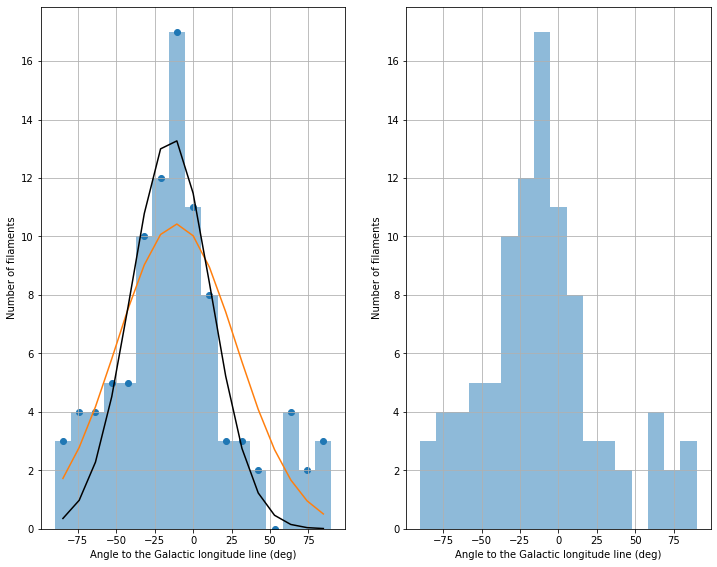

In [60]:
#確率分布のスケールを変える
#確率分布に従って、全データ数と同じ数のサンプルを発生させたときの予測値をプロットする。このとき、プロットの x 座標にはヒストグラムの各ビンの中心を用いる。
fig = plt.figure()
ax1 = plt.subplot(1,2,1)
ax2 = plt.subplot(1,2,2)

plt.rcParams["font.size"] = 18
# plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
# plt.xlabel('Angle to the Galactic longitude line (deg)')
# plt.ylabel('Number of filaments')
mu, sigma = norm.fit(fil_ori_[ypos>400])
_, b, _ = ax1.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
b_mid = np.array([(b[i] + b[i+1]) / 2 for i in range(len(b)-1)]) # ビンの中心の座標を取得
cum = norm.cdf(b, loc=mu, scale=sigma) # 各ビンの端までの累積分布関数の値を計算
n = len(fil_ori_[ypos>400]) # データ点の数
# データ数に、ビンの両端の累積分布関数の値の差をかける
y = [n * (cum[i+1] - cum[i]) for i in range(len(b_mid))]


ax1.plot(b_mid,y) # ビンの中心に、確率分布から予想される高さをプロット
ax1.scatter(b_ls,a)
ax1.plot(b_ls,fitting,'k')

ax1.set_xlabel('Angle to the Galactic longitude line (deg)')
ax1.set_ylabel('Number of filaments')


ax2.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
# plt.xlabel('Angle to the Galactic longitude line (deg)')
# plt.ylabel('Number of filaments')
ax2.set_xlabel('Angle to the Galactic longitude line (deg)')
ax2.set_ylabel('Number of filaments')

ax1.grid()
ax2.grid()
plt.rcParams["font.size"] = 10
#plt.showではなくfig.show()にしないとsubplotの場合はうまくsubplotで表示してくれない！！
# plt.show
fig.show()

[ 1.  0.  1.  1.  0.  2.  1.  3.  9. 10. 18.  4.  9.  2.  0.  2.  2.]
[-90.         -79.41176471 -68.82352941 -58.23529412 -47.64705882
 -37.05882353 -26.47058824 -15.88235294  -5.29411765   5.29411765
  15.88235294  26.47058824  37.05882353  47.64705882  58.23529412
  68.82352941  79.41176471  90.        ]
<BarContainer object of 17 artists>


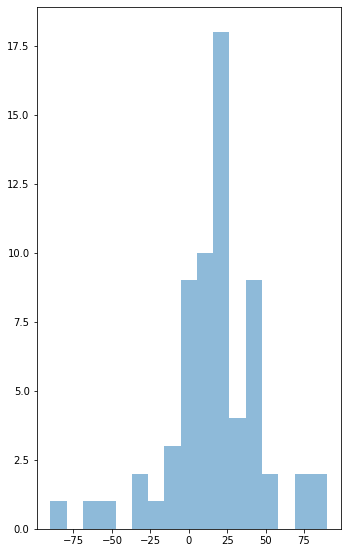

In [87]:
#ax.hist の戻り値の確認
fig = plt.figure()
ax1 = plt.subplot(1,2,1)
mu, sigma = norm.fit(fil_ori_[ypos>400])
a, b, c = ax1.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
print(a)
print(b)
print(c)

In [84]:
c

<BarContainer object of 17 artists>

In [35]:
mu, sigma = norm.fit(fil_ori_[ypos>400]) # 正規分布にフィッティング
print("mu={}, sigma={}".format(mu, sigma)) # mu=558.8994397759103, 

mu=18.948720711454065, sigma=27.35218947924241


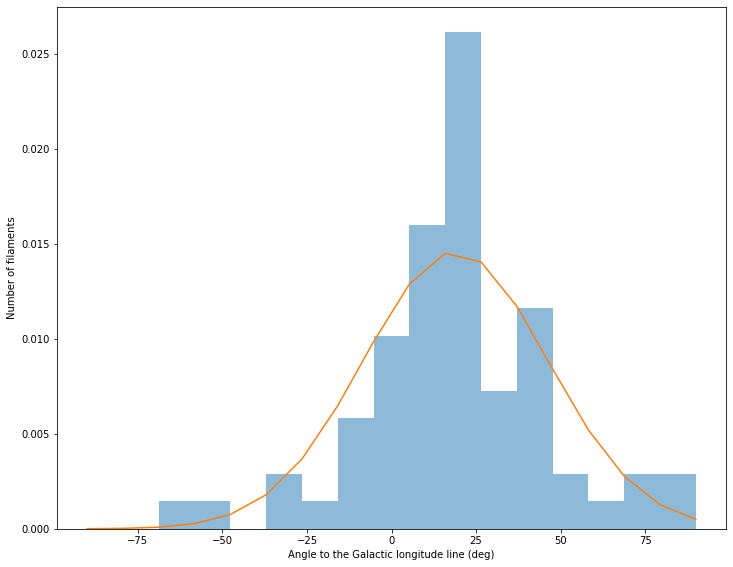

In [37]:
# param = norm.fit(fil_ori_[ypos>400])
# x = np.linspace(-90,90,18)
# pdf_fitted = norm.pdf(x,loc=param[0], scale=param[1])
# pdf = norm.pdf(x)
# plt.title('Normal distribution')
# plt.plot(x, pdf_fitted, 'r-')
# plt.rcParams["font.size"] = 18
# a,b,_ = plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
# n = len(fil_ori_[ypos>400])
# b_width = b[1] - b[0] # ビンの間隔
# a /= n * b_width # 高さを（データ数×ビンの幅）で割る

_, b, _ = plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18), density=True)
plt.plot(b, norm.pdf(b, loc=mu, scale=sigma))



# plt.bar(x=b[:-1], height=a, width=b_width, align="edge") # 再表示
# plt.plot(b, norm.pdf(b, loc=mu, scale=sigma), color='#ff7f0e') # 確率分布をプロット
plt.xlabel('Angle to the Galactic longitude line (deg)')
plt.ylabel('Number of filaments')
plt.rcParams["font.size"] = 10
param = norm.fit(fil_ori_[ypos>400])

# plt.savefig("/home/filament/Downloads/fil_remake/%s_%i_%i_%i_hist.png"%(fits_pwd.split('/')[6].split('.')[0],v_start,v_end,d))

In [26]:
lean_ls = []
pa_deg_map = np.zeros(hdu.data.shape[1:])
for i in range(hdu.data.shape[2]):
    for j in range(hdu.data.shape[1]):
        
        pos = w.wcs_pix2world(i,j,0,0)
        if np.isnan(pos[0])==True or np.isnan(pos[1])==True:
            lean_ls.append(0)
            pa_deg_map[[j],[i]]=np.nan
            continue
        slide_plus = np.array([pos[0],pos[1]+0.0001])
        slide_minus = np.array([pos[0],pos[1]-0.0001])
        slide_plus_pix = w.wcs_world2pix(slide_plus[0],slide_plus[1],0,0)
        slide_minus_pix = w.wcs_world2pix(slide_minus[0],slide_minus[1],0,0)
        vec = np.array(slide_plus_pix) - np.array(slide_minus_pix)
#         vec = np.array([slide_plus_pix[0]-slide_minus_pix[0],slide_plus_pix[1]-slide_minus_pix[1]])
        lean = vec[0]/vec[1]  #
#         print(lean)
#         print(np.arctan(lean))
        lean_ls.append(np.rad2deg(np.arctan(lean)))
        pa_deg_map[[j],[i]]=np.rad2deg(np.arctan(lean))
        
        
    

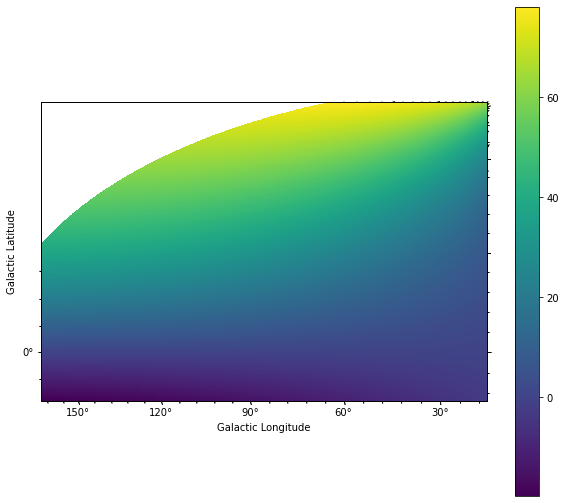

In [27]:
fig = aplpy.FITSFigure(integ_hdu,slices=[0])
plt.imshow(pa_deg_map,origin='lower')
plt.colorbar()

In [45]:
fil_ori_ = []
for f in fil.filaments:
    pa = abs(np.rad2deg(f.orientation.value))-pa_deg_map[int(f.position()[0].value)][int(f.position()[1].value)]
    fil_ori_.append(pa)

In [46]:
fil_ori_=np.array(fil_ori_)

In [47]:
ypos = np.array([f.position()[0].value for f in fil.filaments])

In [51]:
fil_ori_=np.where(fil_ori_<-90,fil_ori_+180,fil_ori_)
fil_ori_=np.where(fil_ori_>90,fil_ori_-180,fil_ori_)
#-90deg以下のものには+180deg、90deg以上のものには-180degをして±90degの範囲に収める。

(array([ 0.,  0.,  0.,  0.,  0.,  0.,  2.,  5., 17.,  8., 14.,  4.,  1.,
         0.,  4.,  2.,  0.]),
 array([-90.        , -79.41176471, -68.82352941, -58.23529412,
        -47.64705882, -37.05882353, -26.47058824, -15.88235294,
         -5.29411765,   5.29411765,  15.88235294,  26.47058824,
         37.05882353,  47.64705882,  58.23529412,  68.82352941,
         79.41176471,  90.        ]),
 <BarContainer object of 17 artists>)

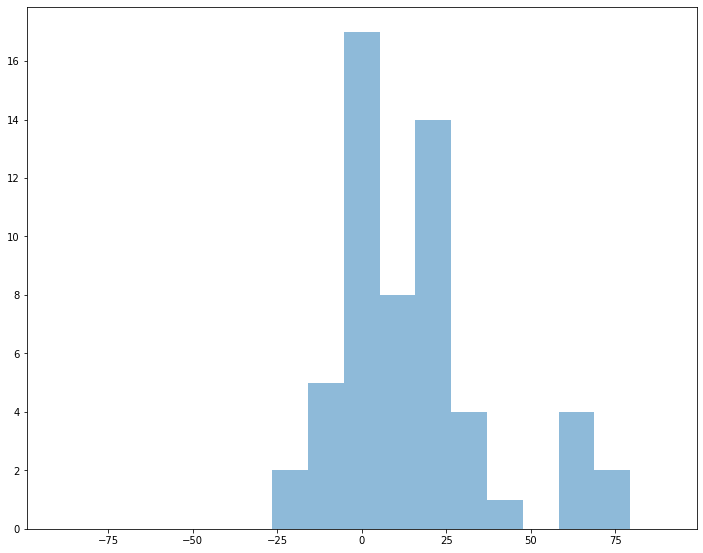

In [53]:
plt.hist(fil_ori_[ypos>400],alpha=0.5,bins=np.linspace(-90,90,num=18))
